In [1]:
from scipy.interpolate import interp1d
from utils import *
import os
from scipy.stats import t
import scipy.io as spi
import math
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from itertools import chain
from Inlier_Thresholder import Inlier_Thresholder
from stats import *

In [2]:
root = '/Users/gabrielegiusti/Desktop/Progetto_IACV/adelH/'
print(os.listdir(root))
data = [f for f in os.listdir(root) if os.path.isfile(root + f)]
data1 = spi.loadmat(root + data[3])
data2 = spi.loadmat(root + data[2])
keypts = data1['data']

['barrsmith.mat', 'physics.mat', 'oldclassicswing.mat', 'library.mat', 'bonhall.mat', 'unihouse.mat', 'elderhalla.mat', 'elderhallb.mat', 'johnsonb.mat', 'sene.mat', 'johnsona.mat', 'neem.mat', 'bonython.mat', 'napierb.mat', 'hartley.mat', 'napiera.mat', 'nese.mat', 'ladysymon.mat']


In [3]:
img1,img2=data1["img1"],data1["img2"]

outliers,models=vi.group_models(data1)["outliers"],vi.group_models(data1)["models"]

src_points = np.array(list(zip(models[0][0], models[0][1])))

dst_points = np.array(list(zip(models[0][2], models[0][3])))

In [4]:
'''
Initialization:
    In order to initialize the Forward Search algorithm we have to find a subset of our points
    completely made of inliers. To do so we can estimate the model by fitting the points with
    the LMEDS robust fitting algorithm. This method has a strong assumption that at least 50%
    of the points must be inliers.
'''

# Computation of the homography with LMEDS
H_LMEDS, mask_LMEDS = verify_LMEDS_H(src_points, dst_points)

init_pts = src_points[np.argsort(mask_LMEDS)[::-1]]

print(np.argsort(mask_LMEDS)[::-1])

47.0 inliers found
[49 48 22 21 20 19 18 17 16 15 14 13 12 11  9  8  7  6  5  4  3  2  1 23
  0 25 26 47 46 45 44 42 41 40 39 38 37 36 35 34 33 32 31 30 29 28 27 10
 43 24]


# Forward Search implementation

In [5]:
# Forward search algorithm for outlier detection
def forward_search(init_pts, dst_pts, use_t=False, significance=0.05):
    num_correspondences = len(init_pts)
    H, mask = verify_LMEDS_H(init_pts, dst_pts, verbose=False)
    sorted_indices = np.argsort(compute_residual(init_pts, dst_pts, H))
    inliers = sorted_indices[:math.floor(len(sorted_indices)/5)]
    scores = compute_residual(init_pts[inliers], dst_pts[inliers], H)

    inliers = inliers.tolist()
    scores = scores.tolist()

    threshold = np.median(scores)

    for i in range(math.floor(len(sorted_indices)/5)+1, num_correspondences):
        new_inliers = deepcopy(inliers)
        new_inliers.append(sorted_indices[i])

        H, mask = verify_LMEDS_H(init_pts[new_inliers], dst_pts[new_inliers], verbose=False)

        inliers = new_inliers

        new_score = compute_residual(init_pts[new_inliers[-1]].reshape((1,2)), dst_pts[new_inliers[-1]].reshape((1,2)), H)

        scores.append(new_score[0])

        if use_t:
            it = Inlier_Thresholder(np.array(scores).reshape(-1))

            _, new_threshold = it.use_best_method()

            t_statistics, p_value = compute_t_test(new_threshold, scores)

            if p_value < significance:

                threshold = new_threshold

    if not use_t:
        it = Inlier_Thresholder(np.array(scores).reshape(-1))

        _, threshold = it.use_best_method()

        # find the minimum between the threshold and the (threshold * np.mean(scores))/np.mean(scores)**2
        # because we want to be strict in the selection of the outliers.
        # using (threshold * np.mean(scores))/np.mean(scores)**2 means that we are normalizing the threshold wrt the mean of the scores
        # because I observed that, if we have just a big error over a score set that contains, for example, 100 low residuals (inliers),
        # that high residual introduce a bias in the estimation of the threshold. In order to mitigate the bias I've done this operation
        # of scaling the threshold found with the class InlierThresholder
        true_threshold_idx = np.where(scores < min((threshold * np.mean(scores))/np.mean(scores)**2, threshold))[-1][-1]

        threshold = scores[true_threshold_idx]

    return inliers, sorted(scores), threshold


def plot_forward_search(data, title='', use_t=False, significance=0.05):

    outliers, models = vi.group_models(data)["outliers"], vi.group_models(data)["models"]

    points = extract_points(models, data)

    thresholds = []

    for l in np.unique(points[3]):

        src_points = points[1][np.where(points[3] == l)]

        dst_points = points[2][np.where(points[3] == l)]

        H_LMEDS, mask_LMEDS = verify_LMEDS_H(src_points, dst_points)

        init_pts = src_points[np.argsort(mask_LMEDS)[::-1]]

        # Perform forward search
        inliers, scores, threshold = forward_search(init_pts, dst_pts=dst_points[np.argsort(mask_LMEDS)[::-1]], use_t=use_t, significance=significance)

        thresholds.append(threshold)

        # Plot actual scores
        plt.plot(range(1, len(scores) + 1), scores)

        # Calculate approximate envelopes using order statistics
        group_size = len(scores) // 10  # Divide into groups of 10% of total correspondences
        min_scores = [min(scores[i:i + group_size]) for i in range(0, len(scores), group_size)]
        max_scores = [max(scores[i:i + group_size]) for i in range(0, len(scores), group_size)]
        x_values = np.arange(1, len(scores) + 1, group_size)
        f_min = interp1d(x_values, min_scores, kind='previous')
        f_max = interp1d(x_values, max_scores, kind='previous')

        # Plot approximate envelopes
        plt.plot(x_values, f_min(x_values), 'r--', label='Lower Envelope')
        plt.plot(x_values, f_max(x_values), 'g--', label='Upper Envelope')

        plt.axhline(threshold, linestyle='--')

        plt.xlabel('Number of Correspondences')
        plt.ylabel('Residual Scores ' + str(np.mean(scores)))
        plt.title('Forward Search with Approximate Envelopes ' + title + ' model ' + str(l))
        plt.legend()
        plt.grid(True)
        plt.show()

    return thresholds


In [6]:
directory = '/Users/gabrielegiusti/Desktop/Progetto_IACV/adelH'

# List all files in the directory
files = os.listdir(directory)

# Filter out only the .mat files
mat_files = [file for file in files if file.endswith('.mat')]

# Load each .mat file
mat_data = {}
names=[]
for file in mat_files:
    file_path = os.path.join(directory, file)
    names.append(file)
    mat_data[file] = spi.loadmat(file_path)

50.0 inliers found
51
51


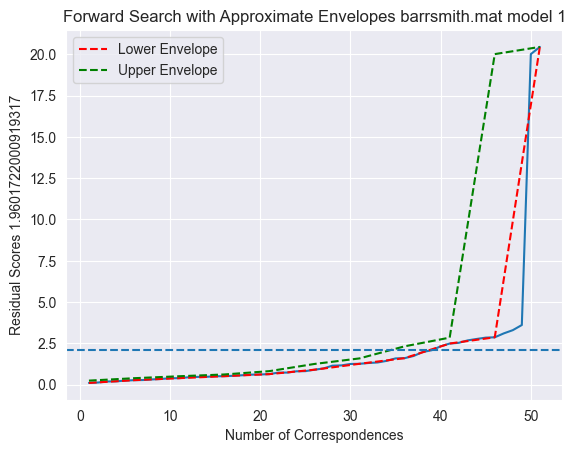

21.0 inliers found
22
22


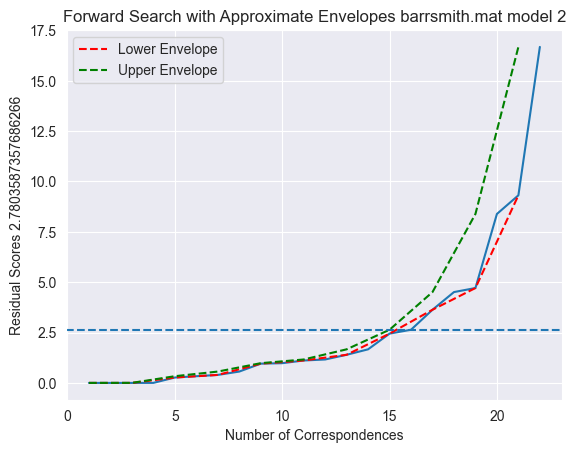

58.0 inliers found
57
57


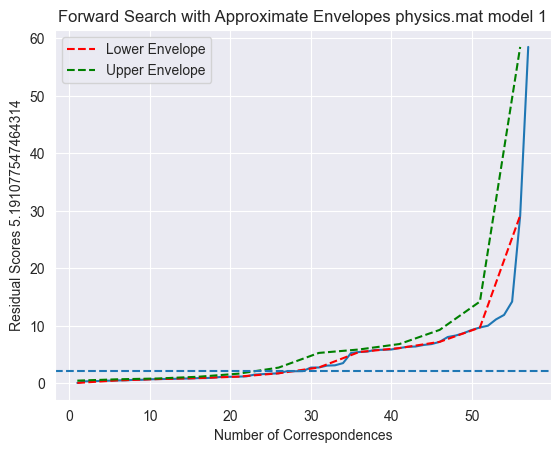

178.0 inliers found
184
184


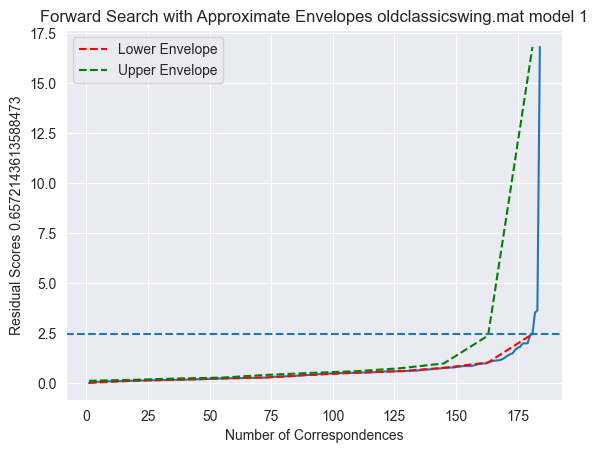

66.0 inliers found
70
70


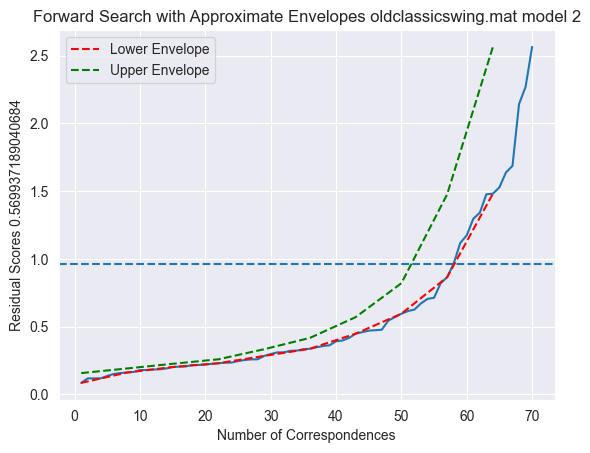

47.0 inliers found
49
49


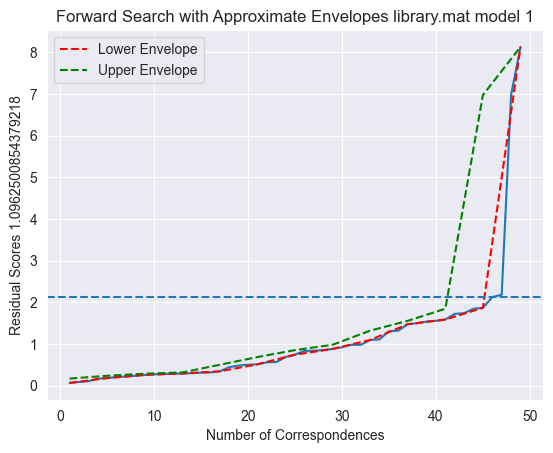

43.0 inliers found
45
45


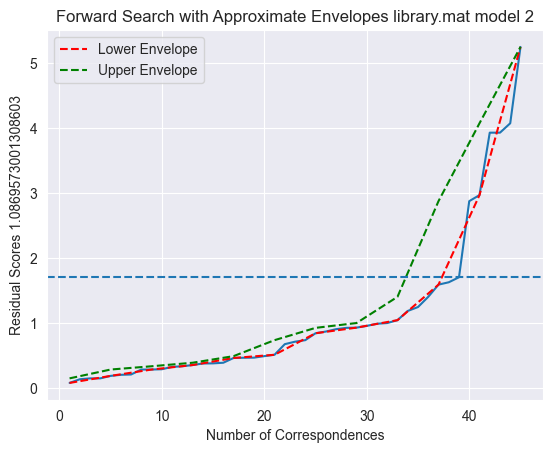

105.0 inliers found
104
104


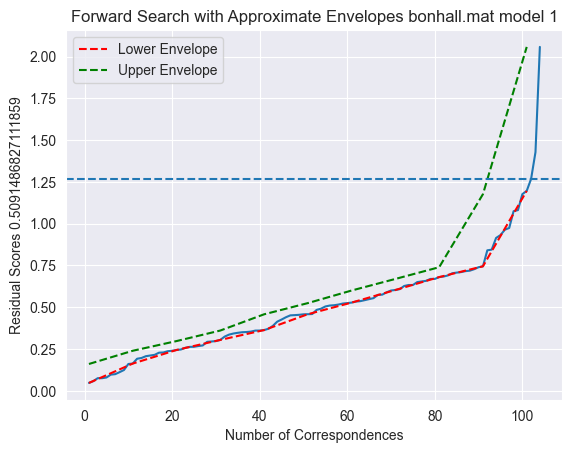

304.0 inliers found
303
303


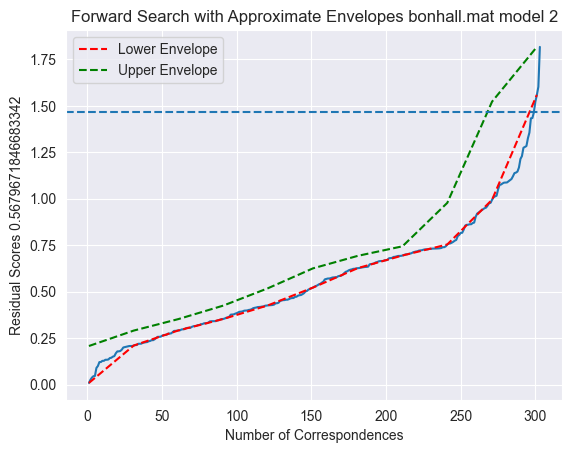

61.0 inliers found
60
60


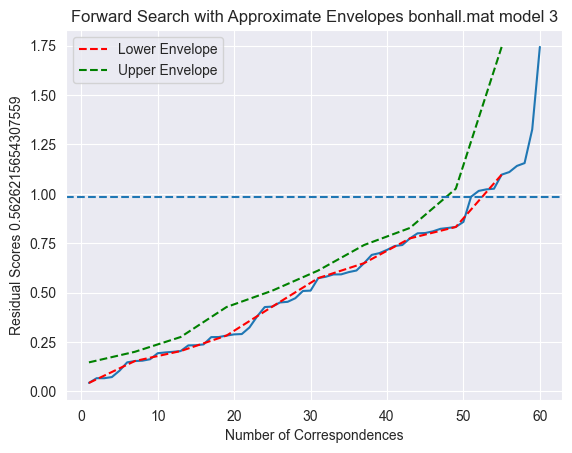

337.0 inliers found
338
338


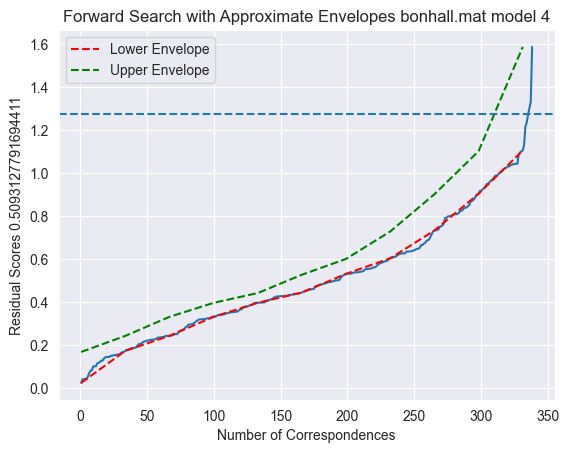

77.0 inliers found
76
76


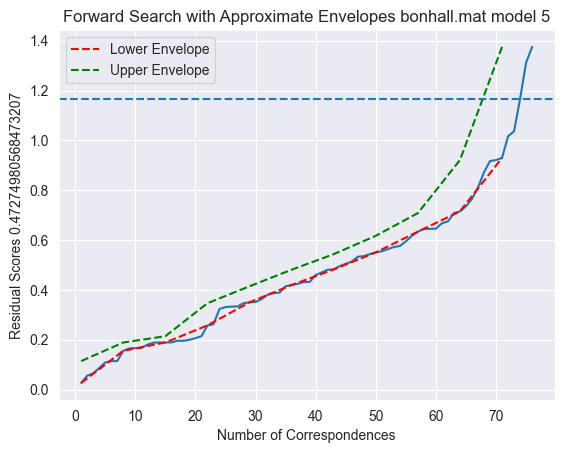

116.0 inliers found
115
115


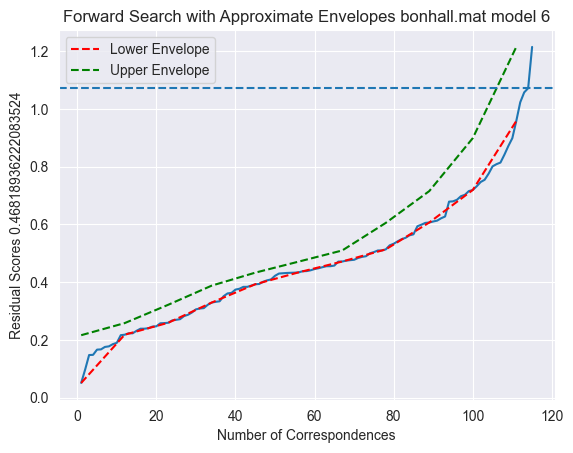

500.0 inliers found
499
499


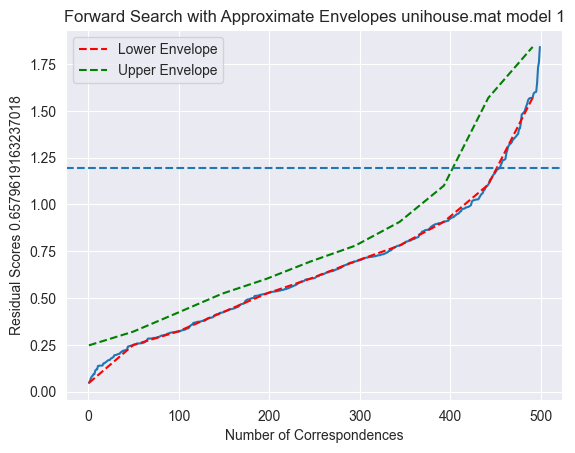

86.0 inliers found
86
86


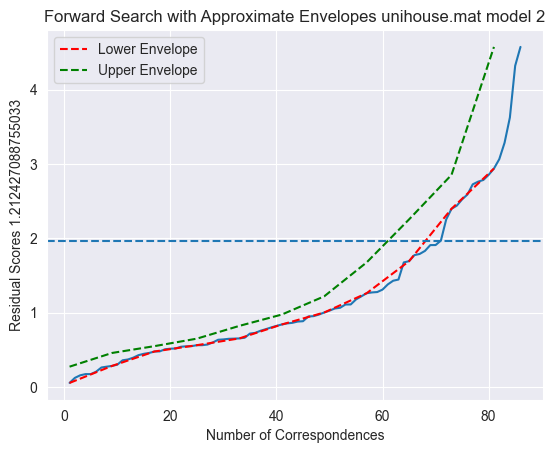

496.0 inliers found
495
495


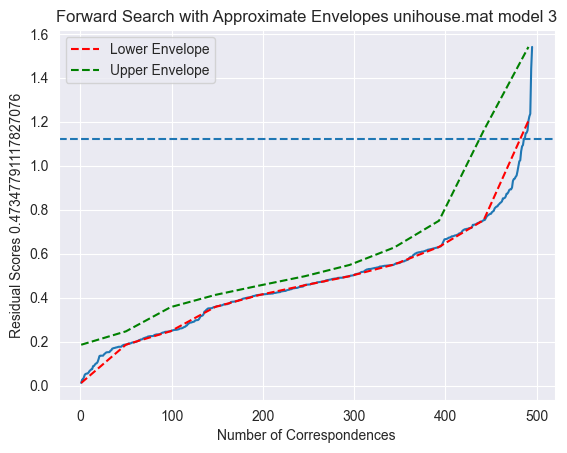

500.0 inliers found
499
499


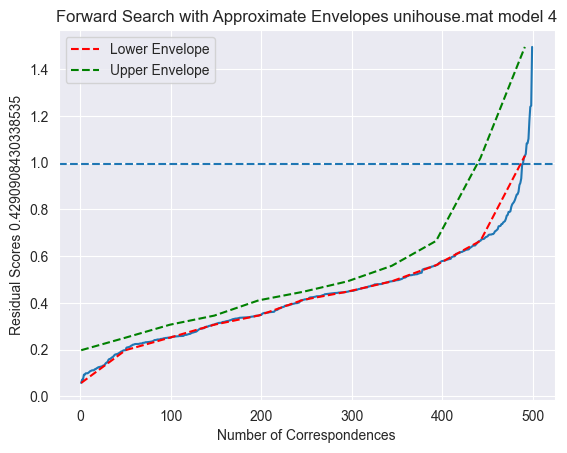

156.0 inliers found
155
155


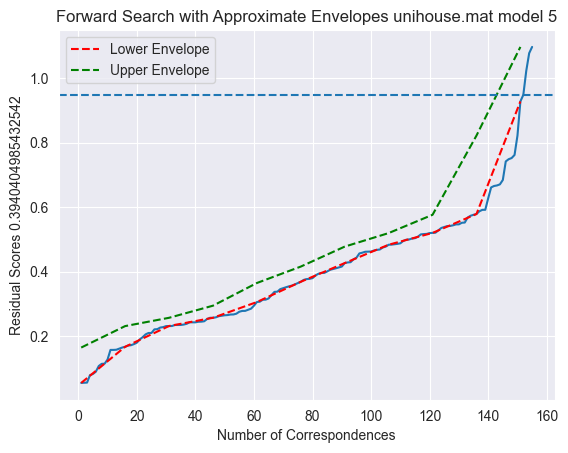

36.0 inliers found
37
37


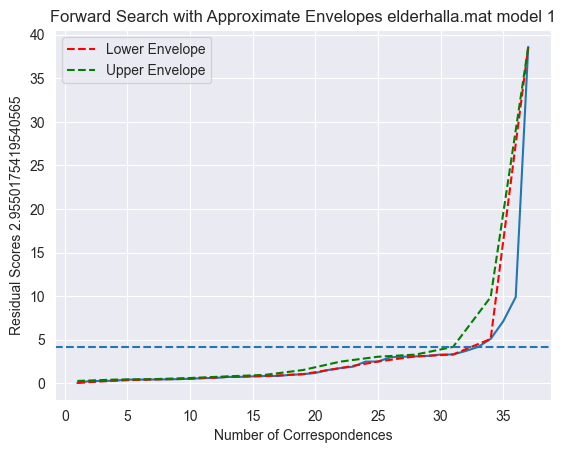

42.0 inliers found
45
45


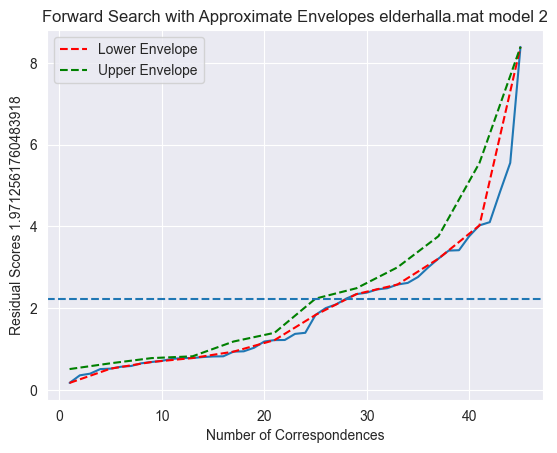

39.0 inliers found
41
41


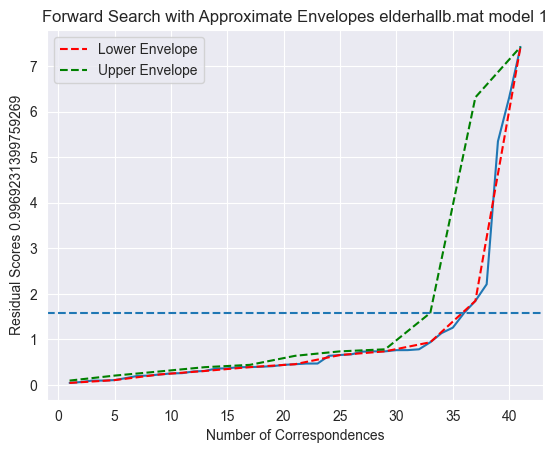

24.0 inliers found
27
27


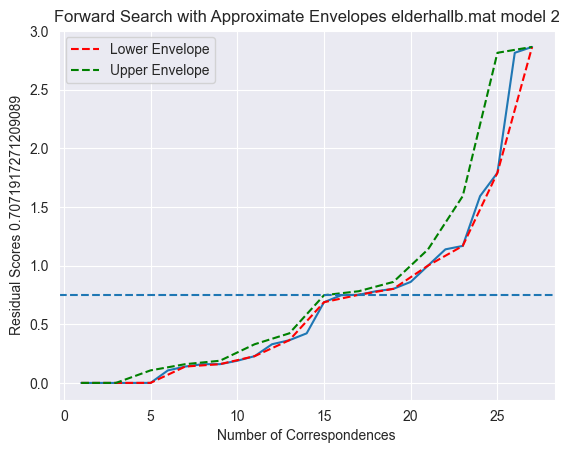

52.0 inliers found
62
62


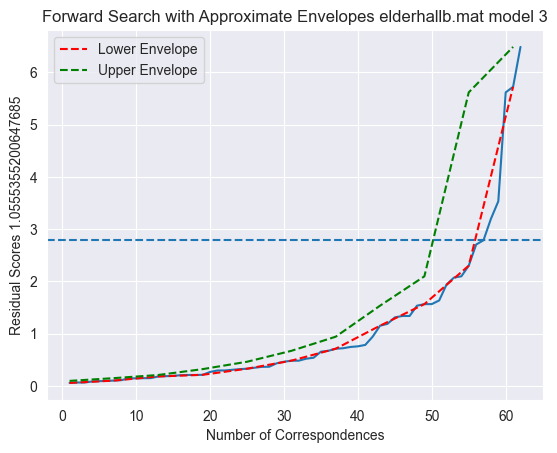

16.0 inliers found
19
19


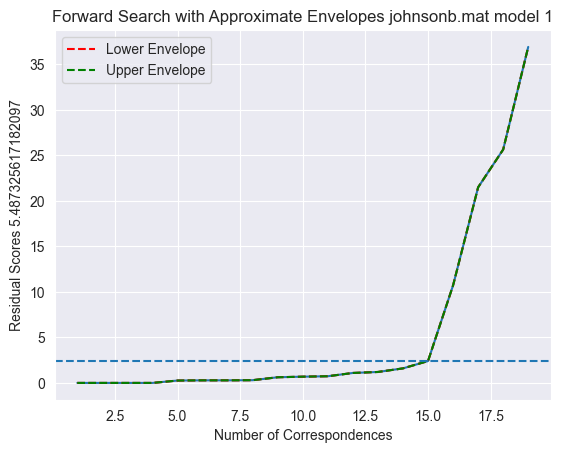

68.0 inliers found
76
76


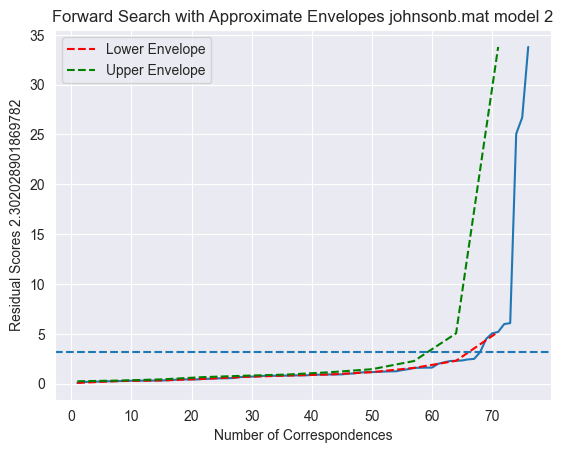

254.0 inliers found
290
290


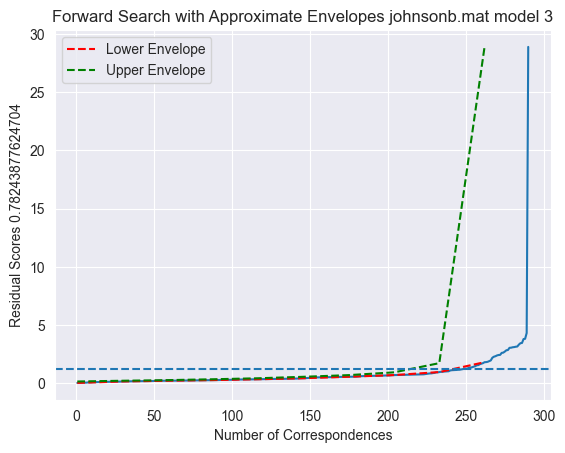

63.0 inliers found
68
68


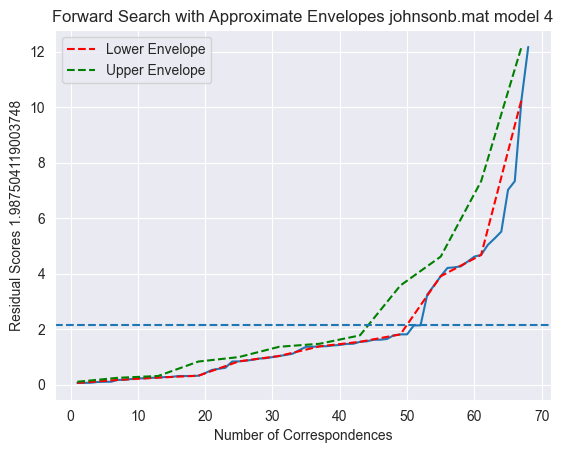

30.0 inliers found
40
40


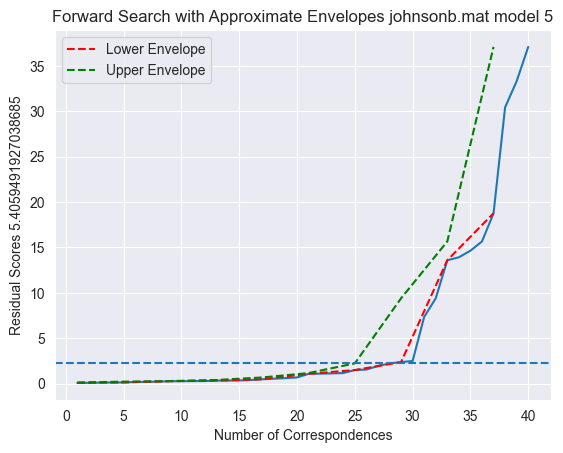

15.0 inliers found
14
14


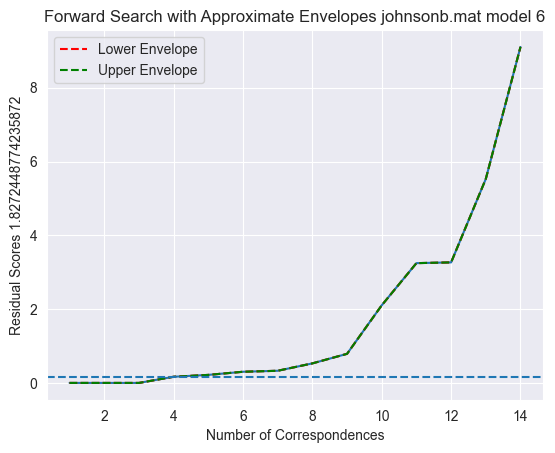

53.0 inliers found
57
57


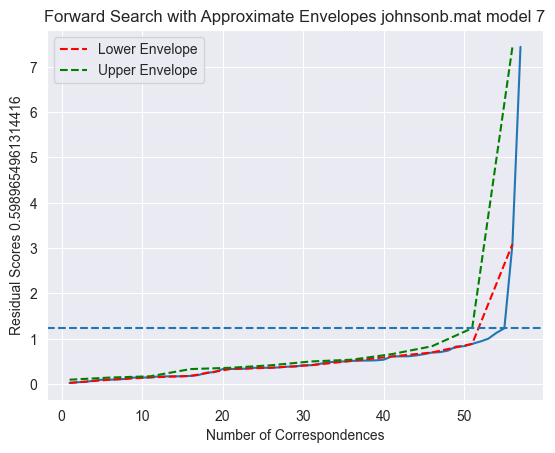

79.0 inliers found
85
85


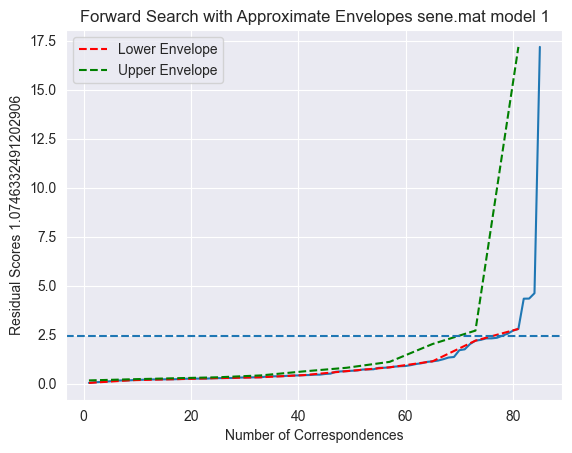

44.0 inliers found
45
45


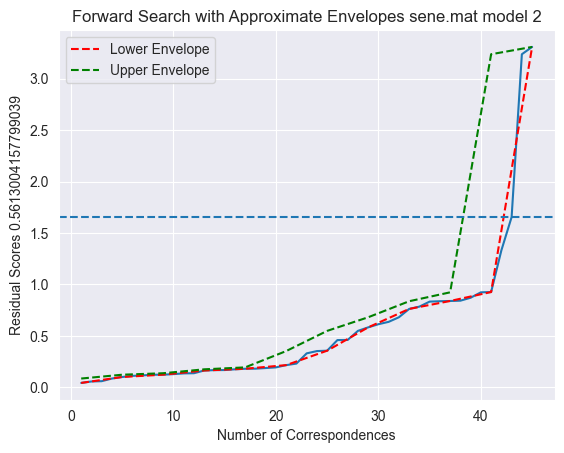

68.0 inliers found
76
76


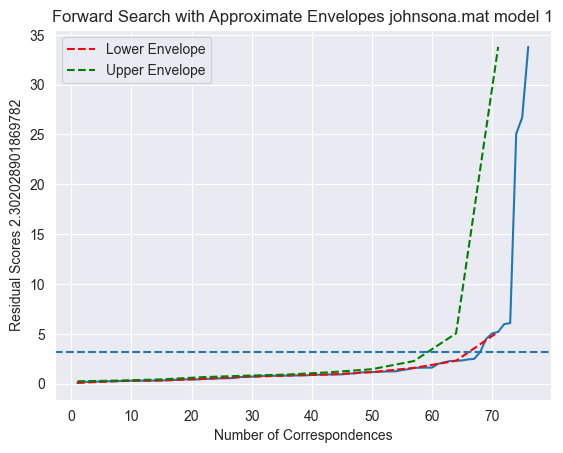

88.0 inliers found
90
90


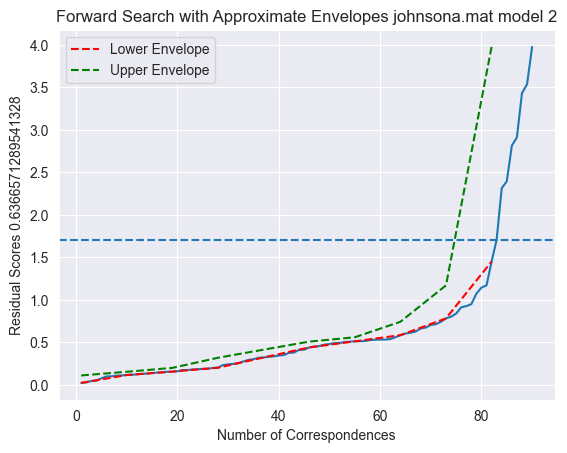

63.0 inliers found
68
68


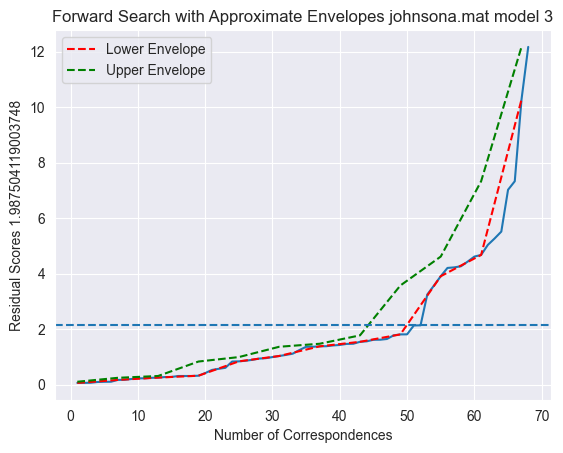

53.0 inliers found
57
57


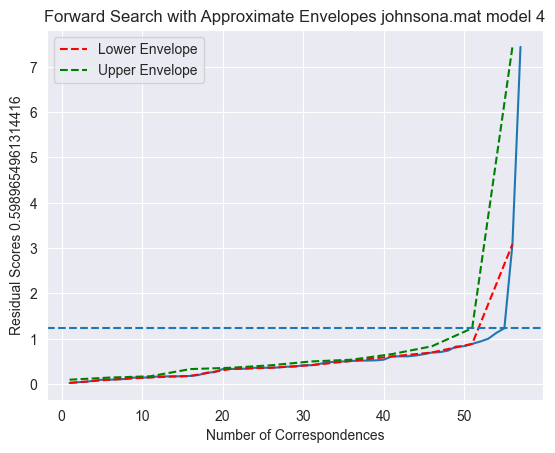

54.0 inliers found
63
63


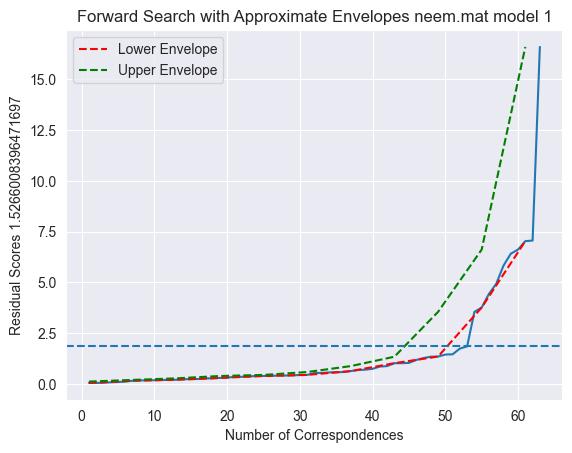

42.0 inliers found
42
42


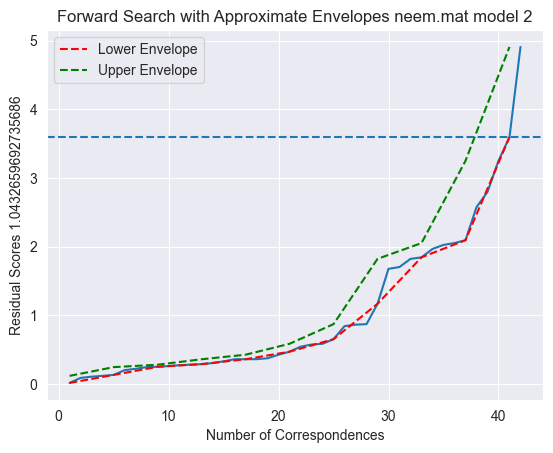

43.0 inliers found
45
45


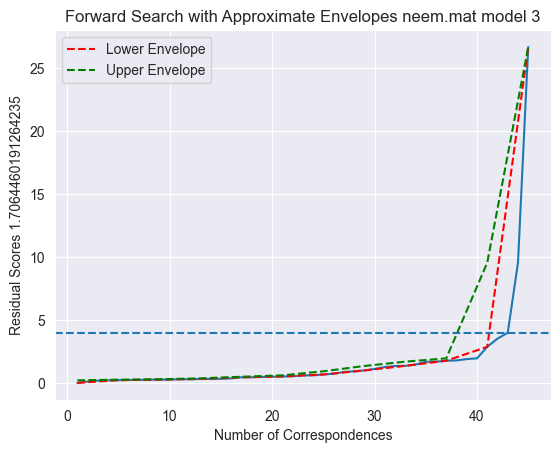

48.0 inliers found
51
51


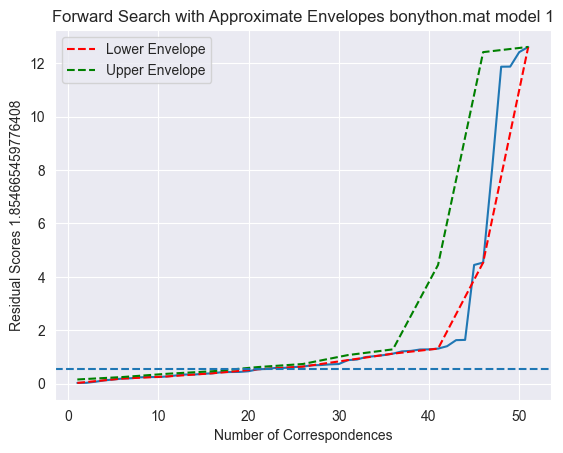

47.0 inliers found
48
48


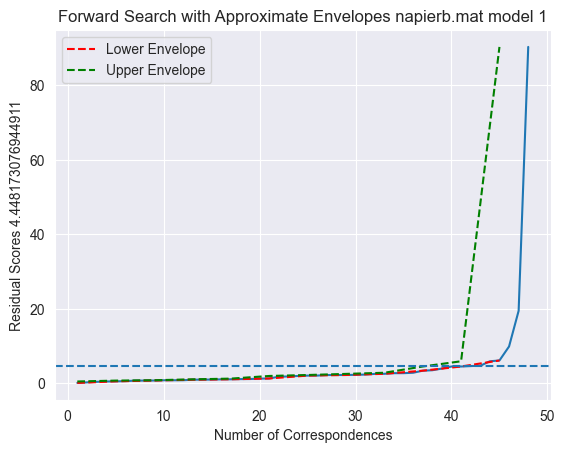

33.0 inliers found
35
35


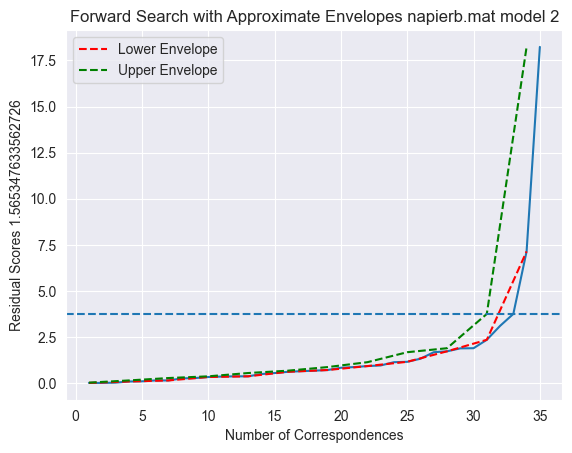

63.0 inliers found
71
71


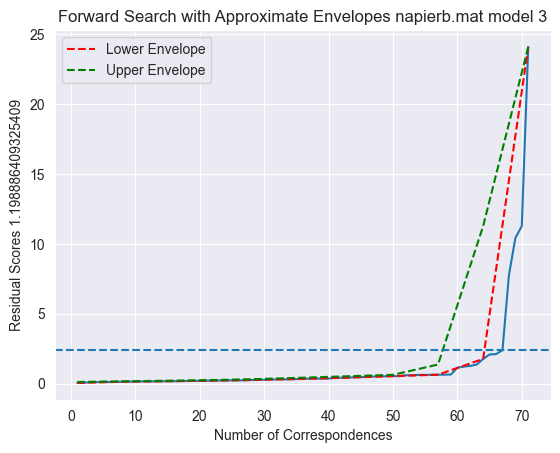

85.0 inliers found
89
89


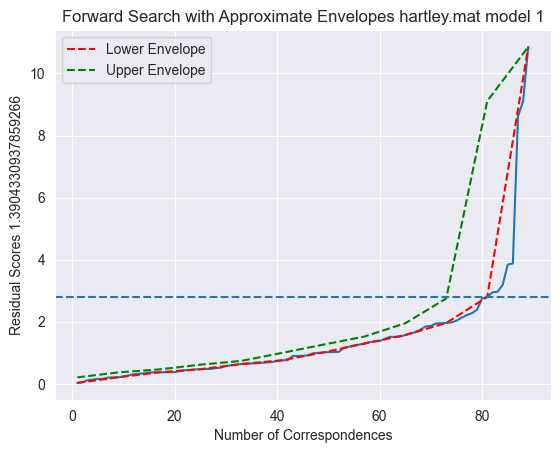

26.0 inliers found
32
32


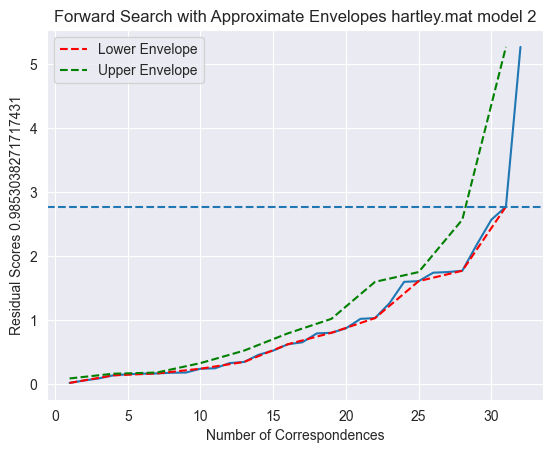

28.0 inliers found
29
29


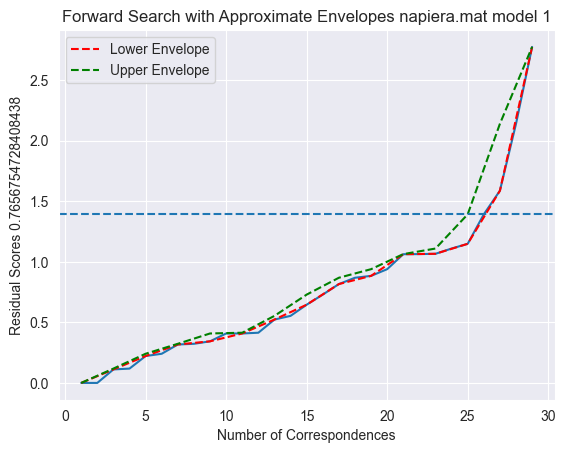

66.0 inliers found
81
81


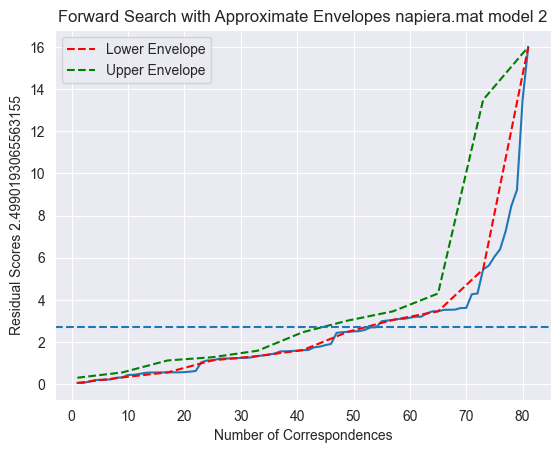

89.0 inliers found
91
91


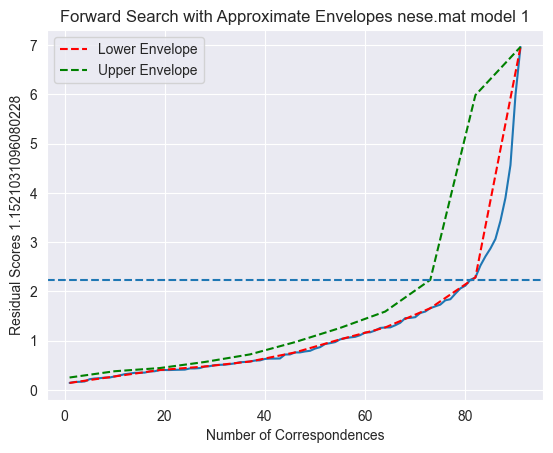

74.0 inliers found
76
76


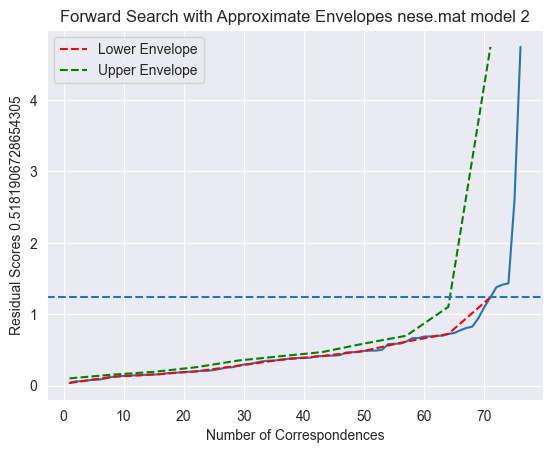

103.0 inliers found
107
107


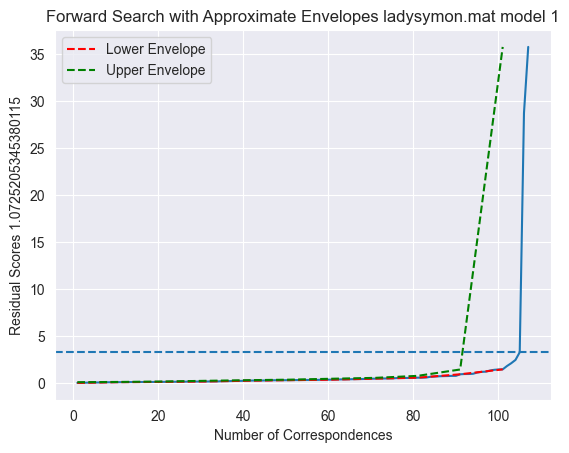

50.0 inliers found
51
51


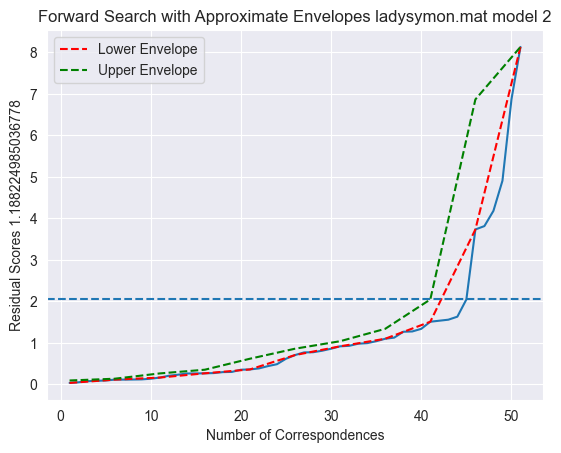

In [15]:
number_of_data_to_analyse=len(names)
thresholds = [[] for i in range(number_of_data_to_analyse)]

for i in range(number_of_data_to_analyse):

    data = mat_data[names[i]]
    thresholds[i].append(plot_forward_search(data, names[i]))


In [16]:
thresholds = list(chain.from_iterable(thresholds))

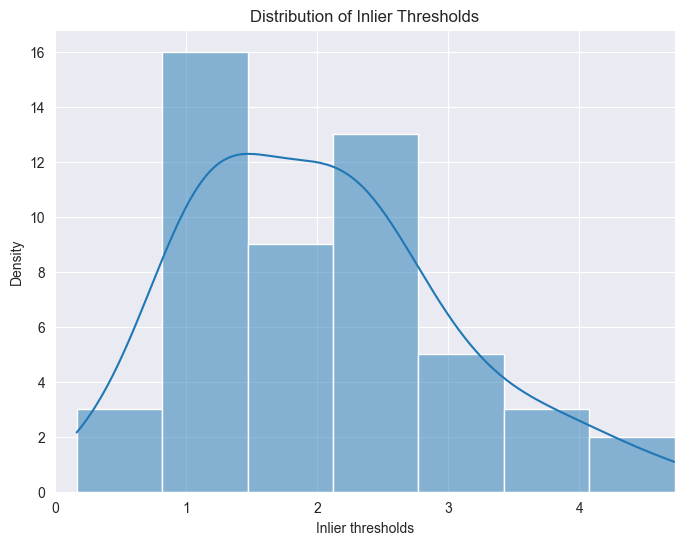

In [17]:
# Create a histogram to visualize the distribution
plt.figure(figsize=(8, 6))
sns.histplot(list(chain.from_iterable(thresholds)), bins='auto', kde=True)  # kde=True plots a kernel density estimate along with the histogram

# Label the axes and add a title
plt.xlabel("Inlier thresholds")
plt.ylabel("Density")
plt.title("Distribution of Inlier Thresholds")

plt.grid(True)
plt.xlim(0, max(max(thresholds)))  # Set limits for silhouette scores (typically between -1 and 1)

# Display the plot
plt.show()

In [18]:
errors = []
average_error = {}
for i in range(len(names)):
    data = mat_data[names[i]]
    res=compute_inliers_residual_curve(data)

    threshold = thresholds[i]
    average_errors = analyze_reprojection_error(data, threshold, method="ransac")
    tmp_vals = average_errors.values()
    min_val = min(tmp_vals)
    idx = 0
    for h in range(len(tmp_vals)):
        if list(tmp_vals)[h] == min_val: idx = h
    min_t = list(average_errors.keys())[idx]
    print("Average reprojection errors for inliers:")
    average_error[min_t] = average_errors.get(min_t)
    for threshold, error in average_errors.items():
        print(f"Threshold: {threshold}, Average Reprojection Error: {error:.4f}")
          #errors.append(error)
    errors.append(average_error[min_t])

36.0 inliers found
38.0 inliers found
Average reprojection errors for inliers:
Threshold: 2.0813529233602144, Average Reprojection Error: 0.6744
Threshold: 2.6403282429092196, Average Reprojection Error: 1.0615
26.0 inliers found
Average reprojection errors for inliers:
Threshold: 2.1116964931391022, Average Reprojection Error: 0.9680
182.0 inliers found
140.0 inliers found
Average reprojection errors for inliers:
Threshold: 2.4704044981127833, Average Reprojection Error: 0.7411
Threshold: 0.9656915236138196, Average Reprojection Error: 0.3880
45.0 inliers found
39.0 inliers found
Average reprojection errors for inliers:
Threshold: 2.123326035628089, Average Reprojection Error: 0.7963
Threshold: 1.7052623037644599, Average Reprojection Error: 0.6581
367.0 inliers found
390.0 inliers found
331.0 inliers found
370.0 inliers found
342.0 inliers found
349.0 inliers found
Average reprojection errors for inliers:
Threshold: 1.2679831639967523, Average Reprojection Error: 0.5127
Threshold: 1.

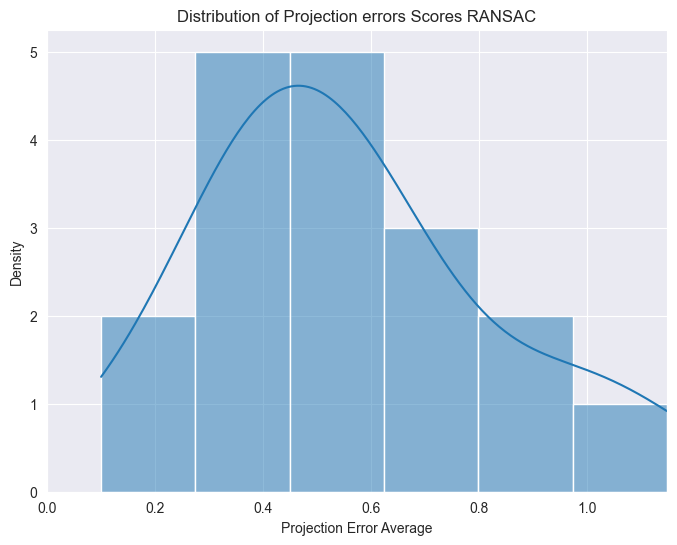

In [19]:
plt.figure(figsize=(8, 6))
sns.histplot(errors, bins='auto',
             kde=True)  # kde=True plots a kernel density estimate along with the histogram

# Label the axes and add a title
plt.xlabel("Projection Error Average")
plt.ylabel("Density")
plt.title("Distribution of Projection errors Scores RANSAC")

plt.grid(True)
plt.xlim(0, max(errors))

# Display the plot
plt.show()

In [20]:
directory = '/Users/gabrielegiusti/Desktop/Progetto_IACV/adelH'

# List all files in the directory
files = os.listdir(directory)

# Filter out only the .mat files
mat_files = [file for file in files if file.endswith('.mat')]

# Load each .mat file
mat_data = {}
names=[]
for file in mat_files:
    file_path = os.path.join(directory, file)
    names.append(file)
    mat_data[file] = spi.loadmat(file_path)

35.0 inliers found
the total number of point is:  52
The indexes of outlier points are: [28, 35, 36, 38, 46, 48, 52, 53, 54, 60, 61, 62, 63, 62, 63, 64, 67, 71, 73]


<Figure size 640x480 with 0 Axes>

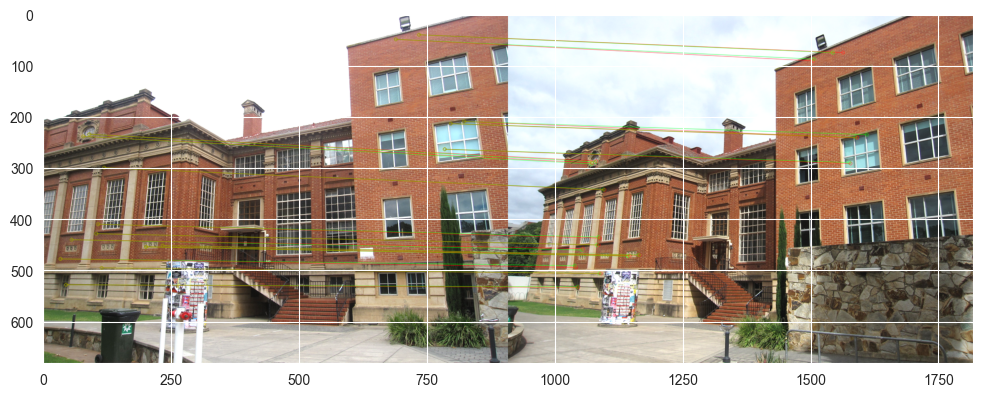

14.0 inliers found
the total number of point is:  23
The indexes of outlier points are: [5, 21, 22, 21, 22, 24, 40, 41, 57, 72, 74]


<Figure size 640x480 with 0 Axes>

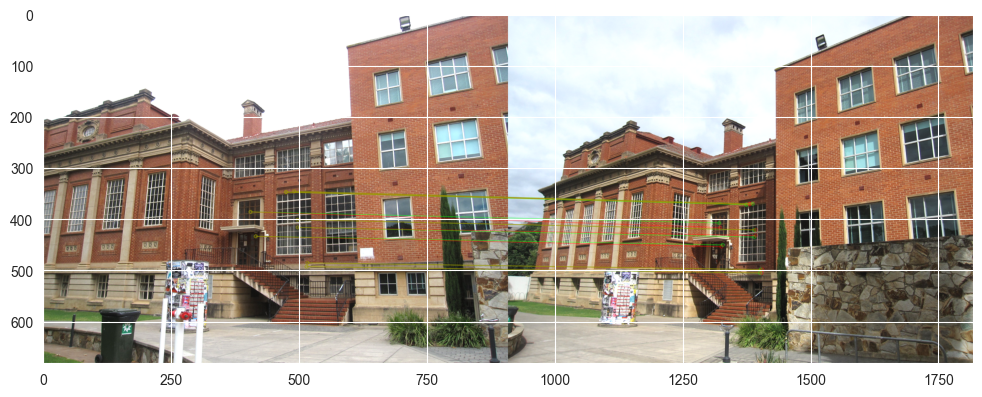

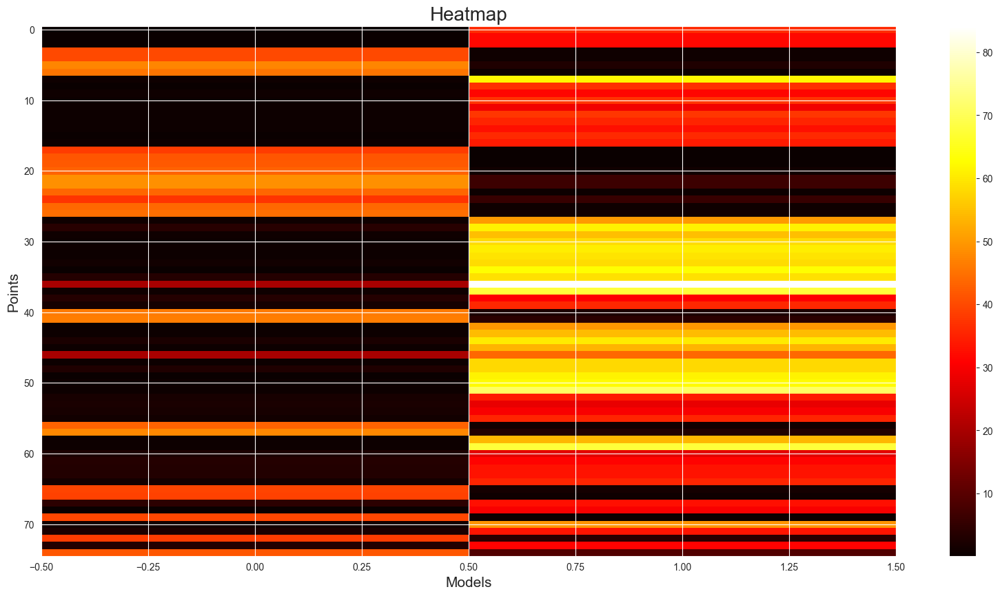

26.0 inliers found
the total number of point is:  58
The indexes of outlier points are: [0, 1, 2, 5, 8, 9, 10, 11, 13, 14, 16, 18, 19, 18, 19, 21, 22, 23, 26, 27, 30, 32, 34, 35, 37, 40, 43, 44, 47, 51, 52, 54, 56, 57]


<Figure size 640x480 with 0 Axes>

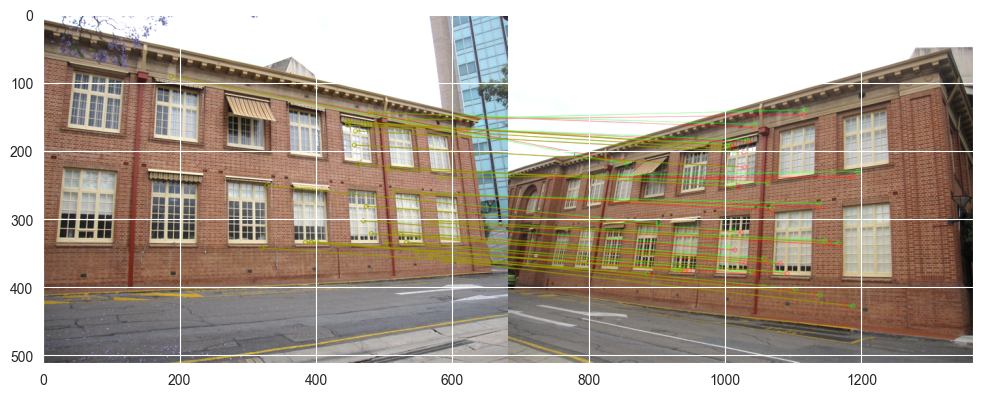

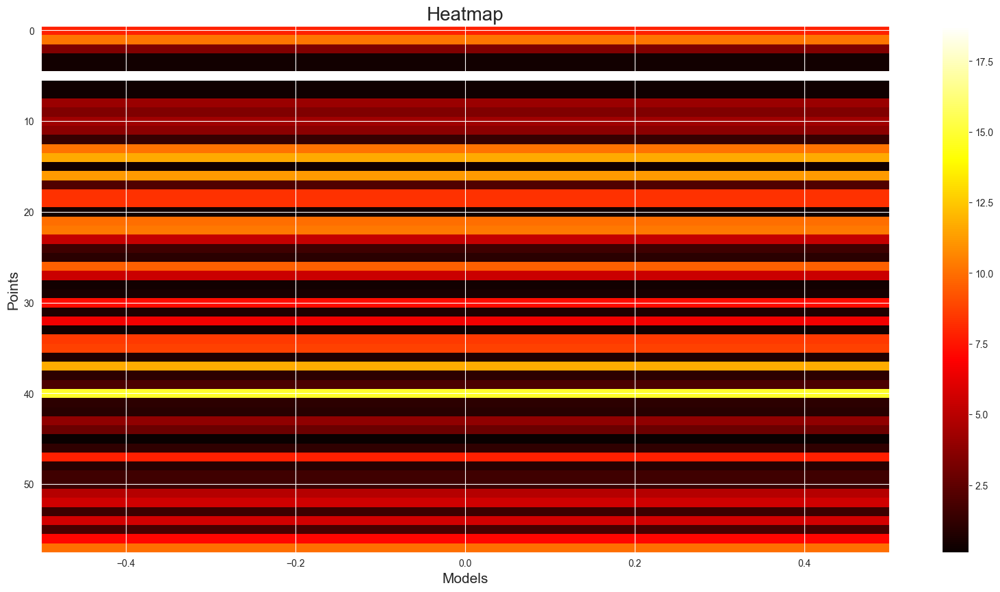

181.0 inliers found
the total number of point is:  185
The indexes of outlier points are: [14, 173, 192, 255]


<Figure size 640x480 with 0 Axes>

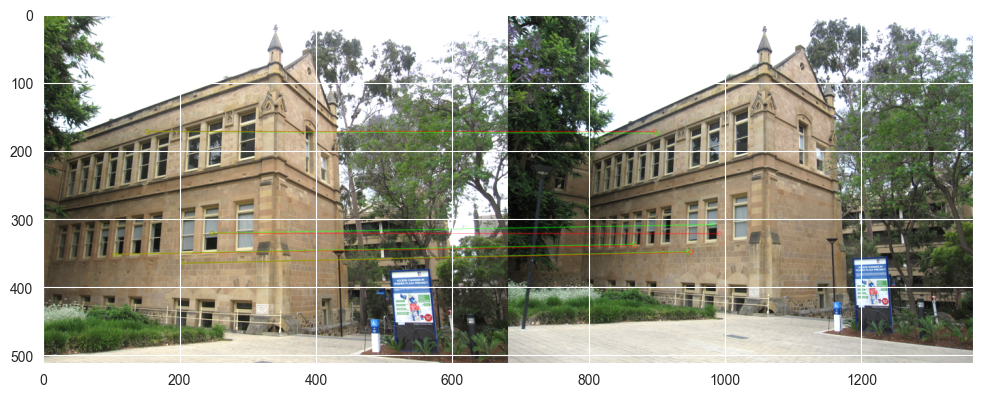

49.0 inliers found
the total number of point is:  71
The indexes of outlier points are: [25, 26, 27, 28, 29, 28, 29, 30, 31, 45, 56, 112, 155, 156, 157, 160, 161, 197, 201, 202, 238, 248, 249, 253]


<Figure size 640x480 with 0 Axes>

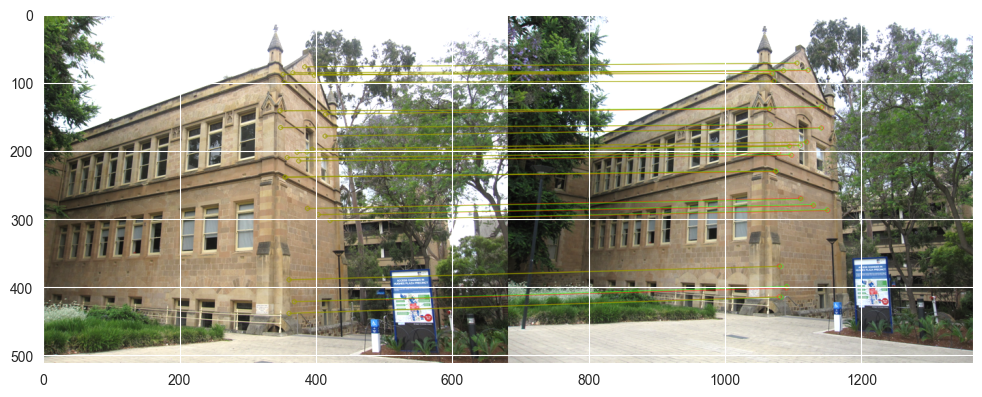

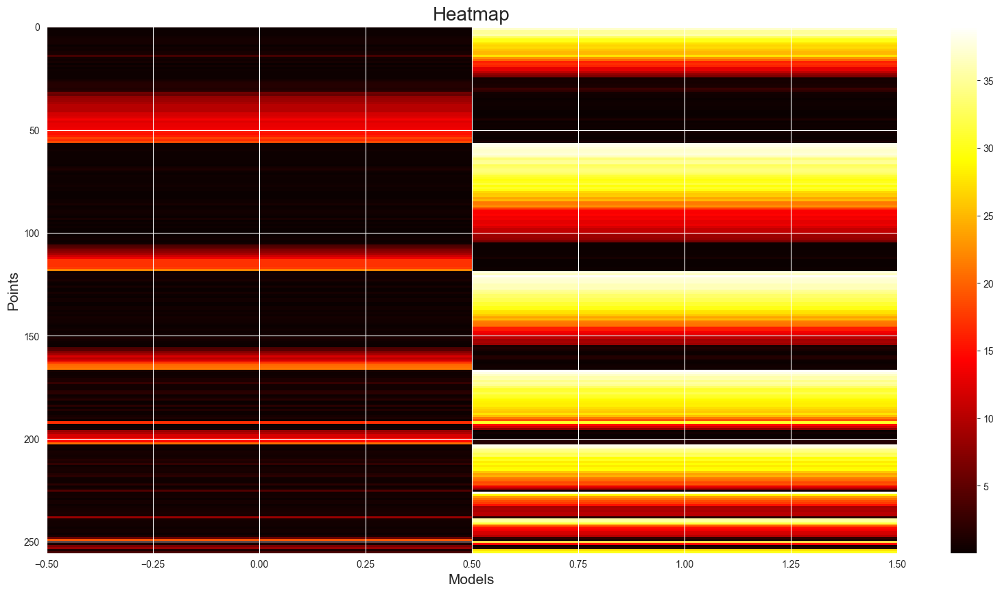

39.0 inliers found
the total number of point is:  50
The indexes of outlier points are: [0, 23, 29, 52, 54, 61, 73, 74, 73, 74, 78, 85, 92]


<Figure size 640x480 with 0 Axes>

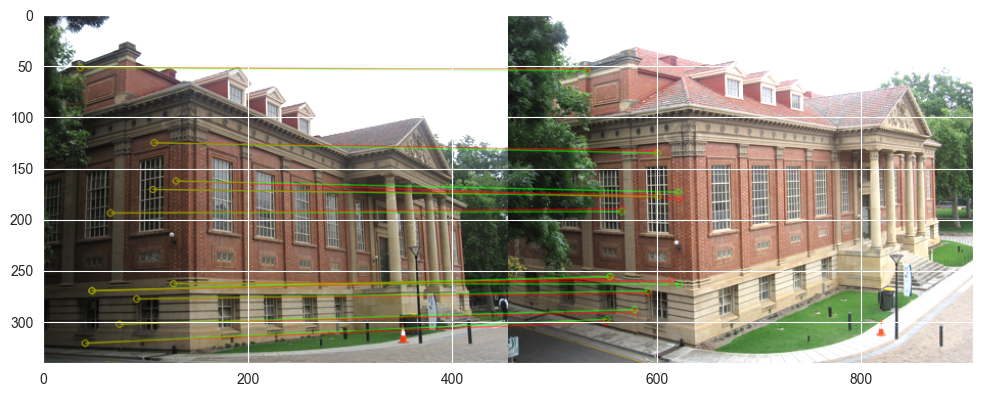

35.0 inliers found
the total number of point is:  46
The indexes of outlier points are: [4, 5, 8, 17, 20, 56, 58, 83, 88, 89, 88, 89, 95]


<Figure size 640x480 with 0 Axes>

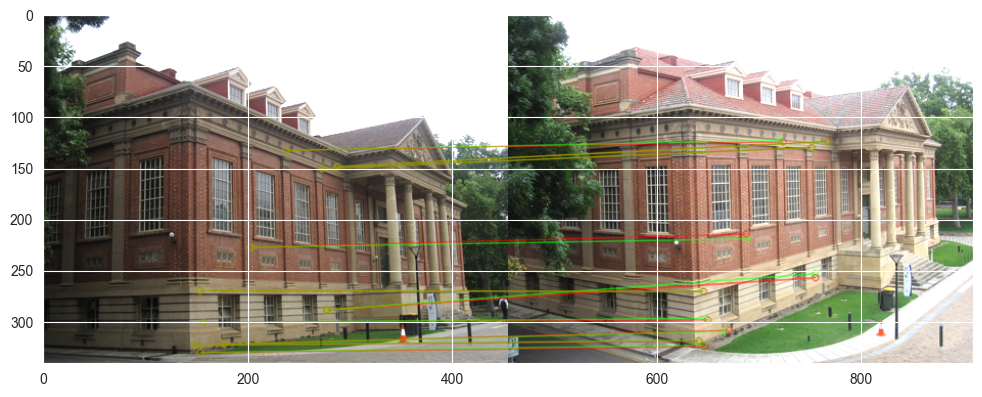

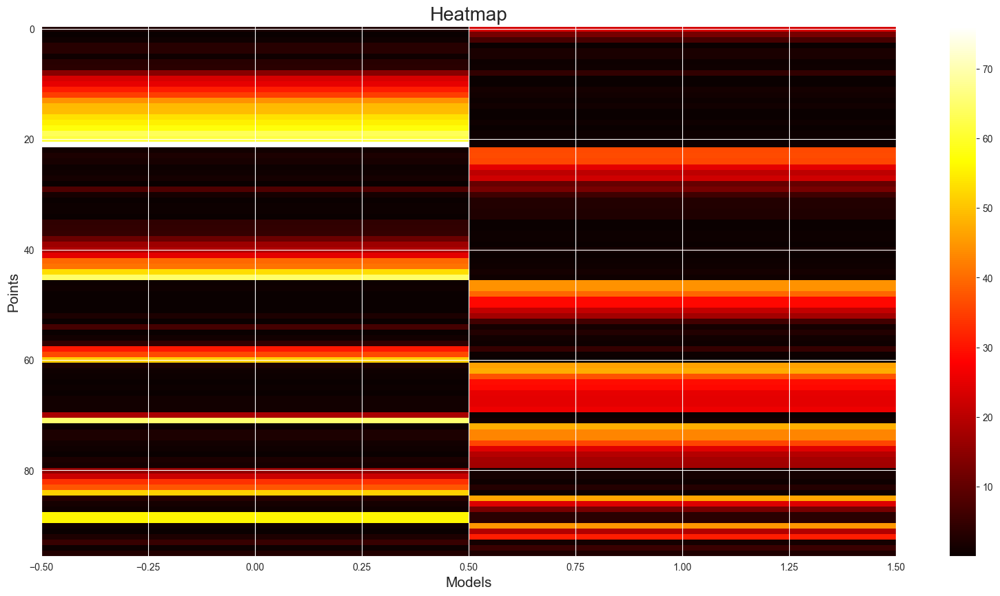

87.0 inliers found
the total number of point is:  105
The indexes of outlier points are: [1, 2, 12, 21, 32, 37, 49, 57, 68, 71, 78, 79, 80, 83, 94, 99, 103, 104]


<Figure size 640x480 with 0 Axes>

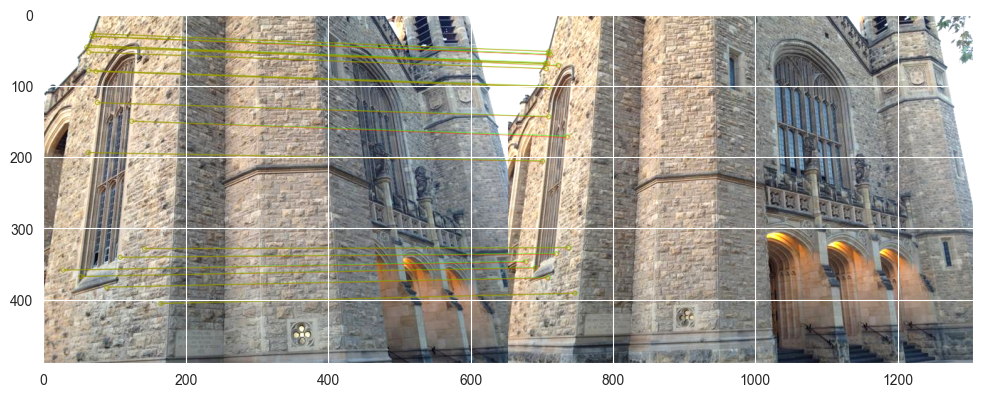

252.0 inliers found
the total number of point is:  304
The indexes of outlier points are: [109, 120, 121, 136, 138, 142, 143, 142, 143, 144, 145, 144, 145, 152, 154, 157, 158, 157, 158, 159, 161, 164, 165, 169, 170, 183, 197, 202, 205, 210, 212, 225, 232, 242, 245, 255, 256, 255, 256, 267, 268, 267, 268, 281, 282, 286, 291, 370, 293, 320, 322, 336, 338, 349, 291, 370, 372, 383, 385, 387, 390, 391, 394, 396]


<Figure size 640x480 with 0 Axes>

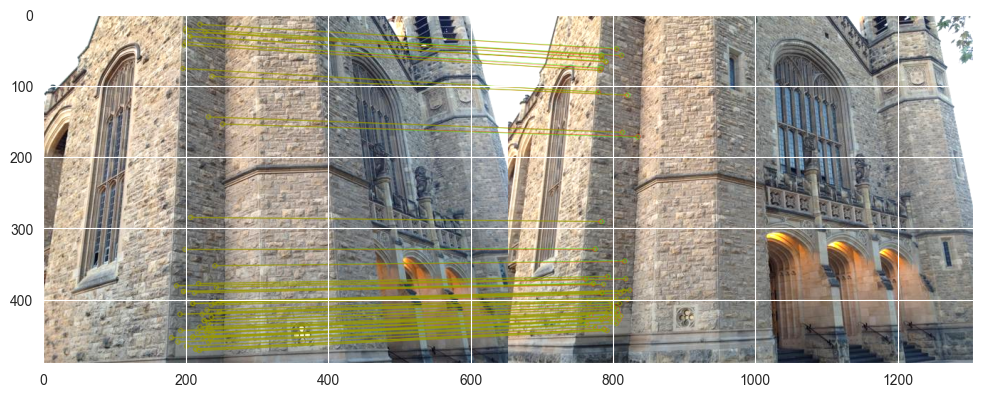

39.0 inliers found
the total number of point is:  61
The indexes of outlier points are: [410, 411, 410, 411, 421, 422, 424, 425, 427, 428, 427, 428, 432, 435, 437, 441, 442, 443, 451, 453, 459, 462, 463, 465, 468, 469]


<Figure size 640x480 with 0 Axes>

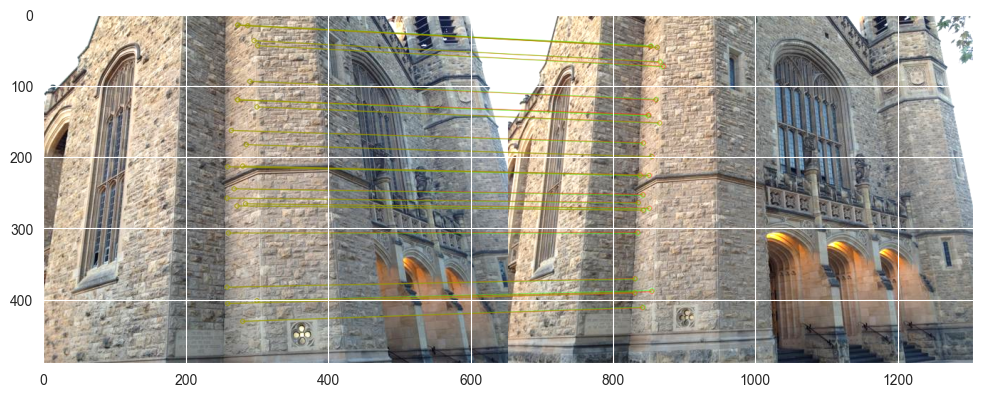

284.0 inliers found
the total number of point is:  339
The indexes of outlier points are: [474, 476, 477, 502, 505, 509, 547, 549, 550, 709, 551, 567, 579, 581, 584, 585, 597, 598, 599, 600, 602, 604, 605, 604, 605, 606, 608, 610, 619, 625, 645, 661, 662, 666, 670, 671, 673, 676, 677, 676, 677, 704, 550, 709, 727, 729, 730, 729, 730, 732, 733, 732, 733, 734, 735, 734, 735, 743, 744, 743, 744, 746, 751, 759, 767, 774, 776, 777, 776, 777, 794]


<Figure size 640x480 with 0 Axes>

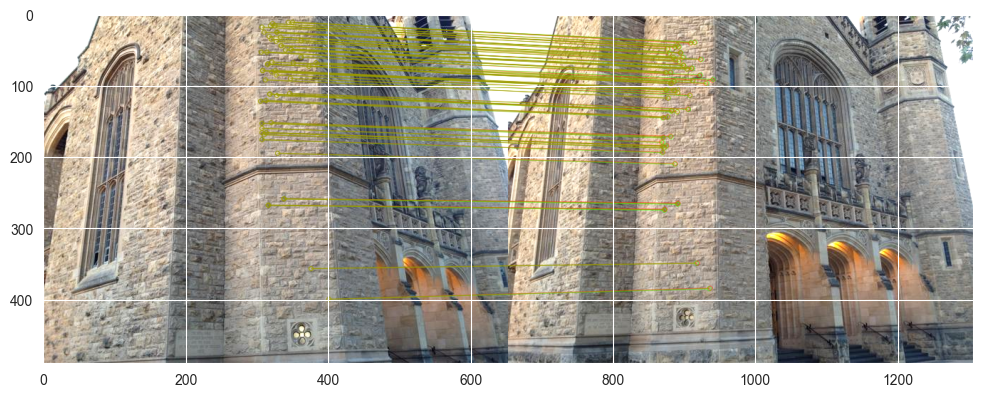

56.0 inliers found
the total number of point is:  77
The indexes of outlier points are: [809, 813, 814, 818, 819, 818, 819, 820, 821, 822, 824, 829, 834, 839, 840, 842, 843, 844, 843, 844, 845, 846, 882, 883, 884]


<Figure size 640x480 with 0 Axes>

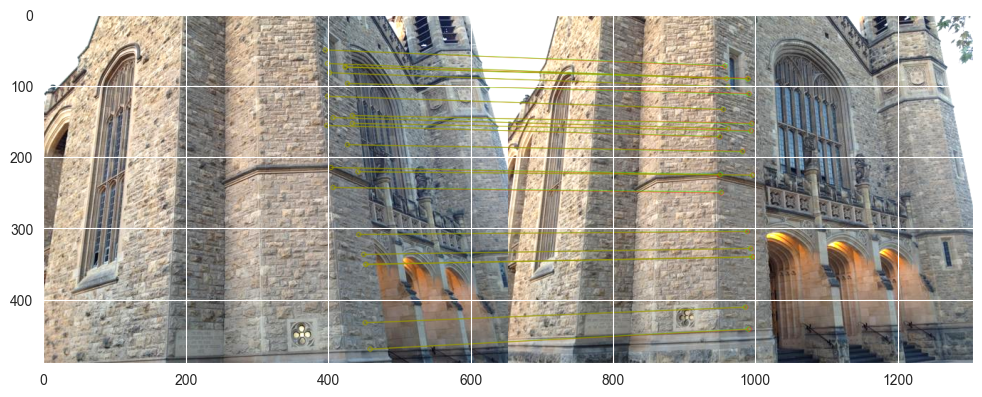

87.0 inliers found
the total number of point is:  116
The indexes of outlier points are: [893, 896, 897, 898, 901, 908, 911, 913, 914, 913, 914, 915, 916, 915, 916, 919, 921, 925, 926, 927, 931, 938, 941, 942, 943, 942, 943, 951, 967, 968, 972, 991, 994, 997, 999]


<Figure size 640x480 with 0 Axes>

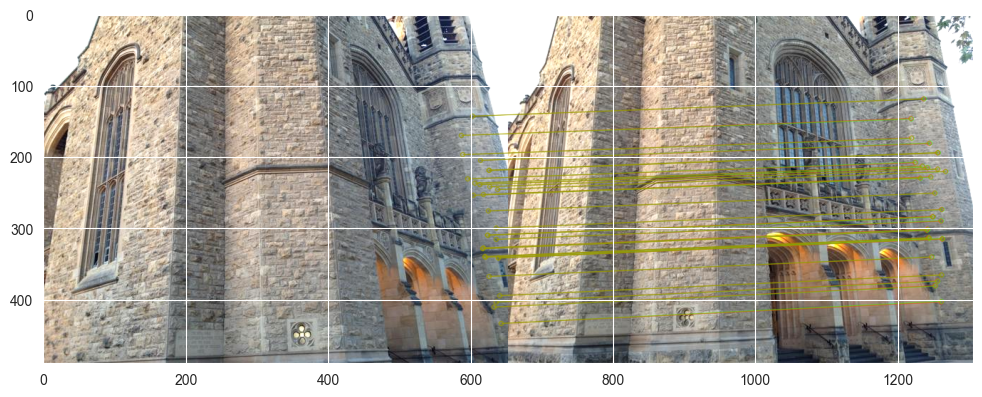

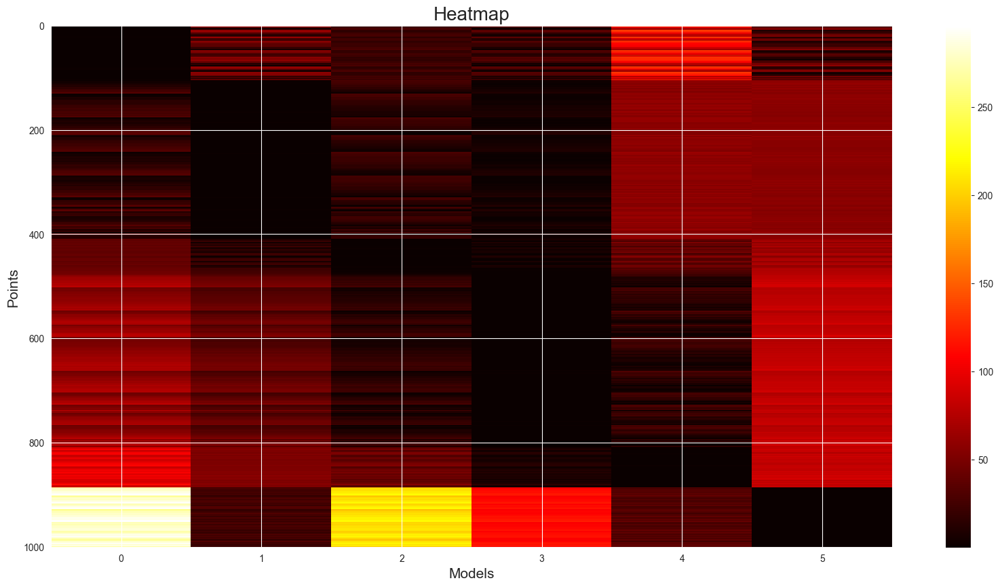

424.0 inliers found
the total number of point is:  500
The indexes of outlier points are: [0, 22, 26, 40, 46, 64, 65, 70, 71, 72, 77, 78, 77, 78, 89, 92, 97, 103, 104, 103, 104, 107, 108, 110, 115, 118, 125, 135, 136, 144, 145, 147, 154, 155, 161, 164, 168, 179, 190, 195, 196, 200, 218, 220, 230, 253, 254, 259, 260, 265, 288, 293, 299, 310, 317, 329, 354, 365, 367, 372, 374, 390, 394, 397, 398, 399, 400, 398, 399, 400, 398, 399, 400, 403, 413, 414, 417, 425, 441, 462, 463, 462, 463, 467, 475, 481, 493, 498]


<Figure size 640x480 with 0 Axes>

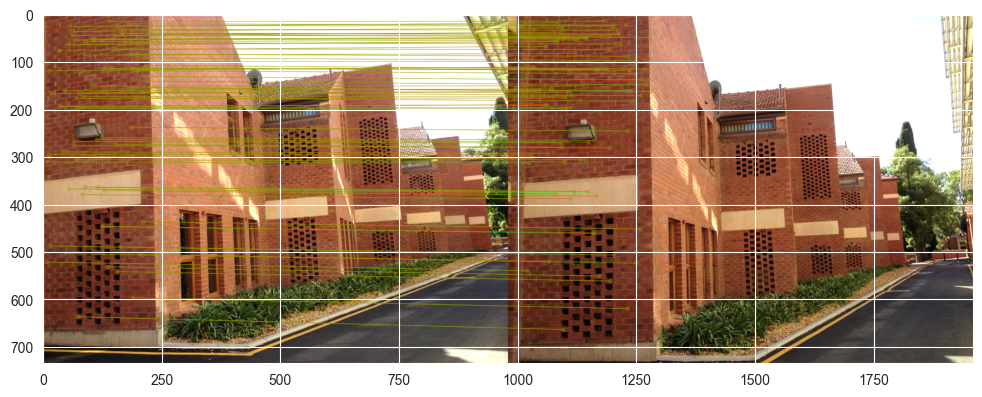

57.0 inliers found
the total number of point is:  87
The indexes of outlier points are: [500, 501, 587, 502, 588, 504, 508, 513, 515, 641, 516, 719, 518, 523, 520, 738, 518, 523, 525, 527, 528, 531, 532, 533, 534, 536, 537, 829, 540, 832, 559, 562, 565, 1071, 566, 1072, 571, 573, 577, 579, 584]


<Figure size 640x480 with 0 Axes>

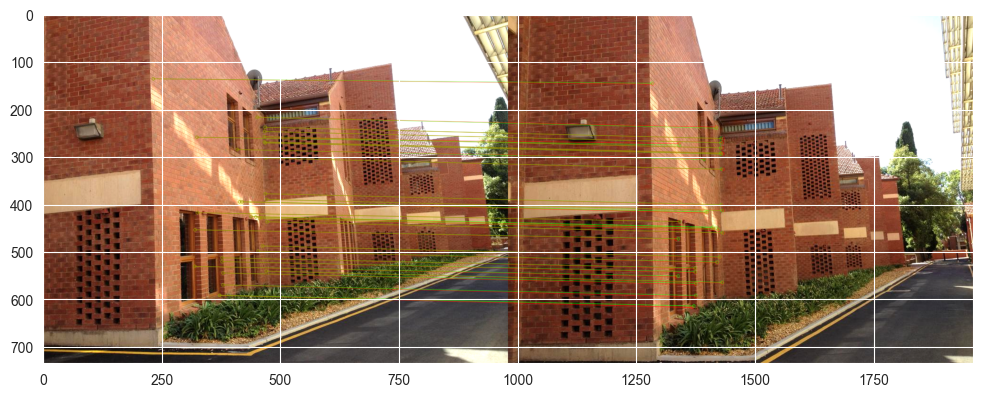

482.0 inliers found
the total number of point is:  496
The indexes of outlier points are: [506, 604, 605, 607, 635, 664, 671, 733, 744, 827, 537, 829, 539, 831, 844, 565, 1071, 1075]


<Figure size 640x480 with 0 Axes>

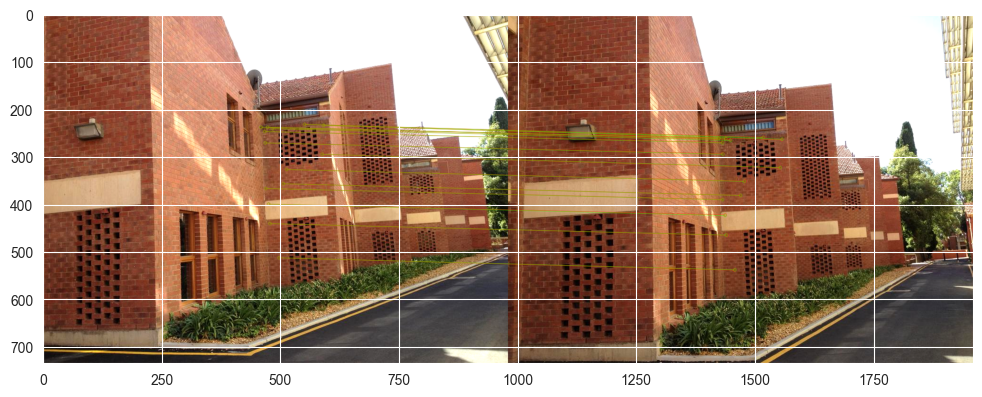

414.0 inliers found
the total number of point is:  500
The indexes of outlier points are: [1083, 1104, 1112, 1114, 1129, 1130, 1129, 1130, 1132, 1140, 1142, 1152, 1153, 1156, 1163, 1164, 1166, 1169, 1173, 1174, 1189, 1190, 1189, 1190, 1206, 1207, 1206, 1207, 1236, 1237, 1239, 1243, 1244, 1245, 1244, 1245, 1250, 1251, 1252, 1253, 1254, 1255, 1254, 1255, 1256, 1315, 1321, 1325, 1326, 1325, 1326, 1329, 1330, 1331, 1332, 1333, 1337, 1339, 1340, 1343, 1349, 1351, 1352, 1353, 1354, 1352, 1353, 1354, 1352, 1353, 1354, 1360, 1367, 1368, 1417, 1443, 1444, 1446, 1447, 1446, 1447, 1459, 1460, 1461, 1462, 1461, 1462, 1465, 1466, 1465, 1466, 1472, 1480, 1481, 1482, 1481, 1482, 1483, 1484, 1485, 1486, 1485, 1486, 1487, 1488, 1487, 1488, 1490, 1492, 1493, 1492, 1493, 1494, 1495, 1494, 1495, 1496, 1499, 1513, 1520]


<Figure size 640x480 with 0 Axes>

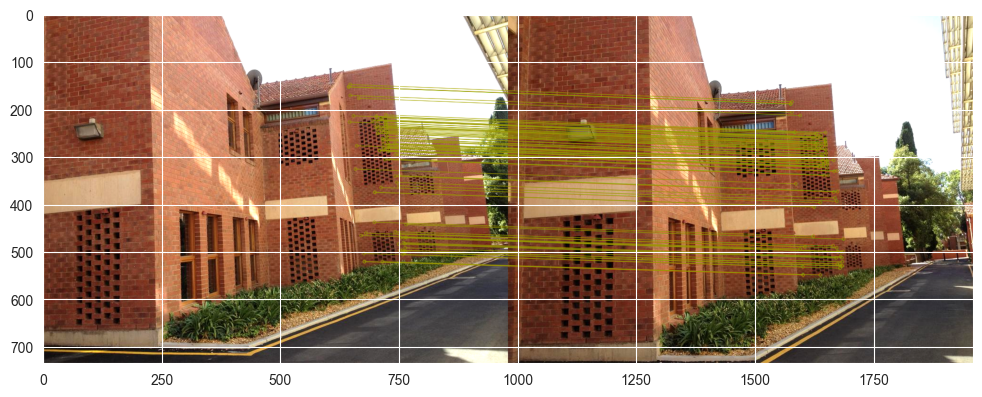

125.0 inliers found
the total number of point is:  156
The indexes of outlier points are: [1588, 1589, 1588, 1589, 1592, 1601, 1603, 1604, 1603, 1604, 1610, 1611, 1616, 1627, 1646, 1648, 1649, 1648, 1649, 1650, 1651, 1650, 1651, 1660, 1669, 1675, 1681, 1689, 1690, 1689, 1690, 1699, 1700, 1711, 1712, 1711, 1712, 1719, 1720, 1721, 1731, 1732, 1731, 1732, 1738]


<Figure size 640x480 with 0 Axes>

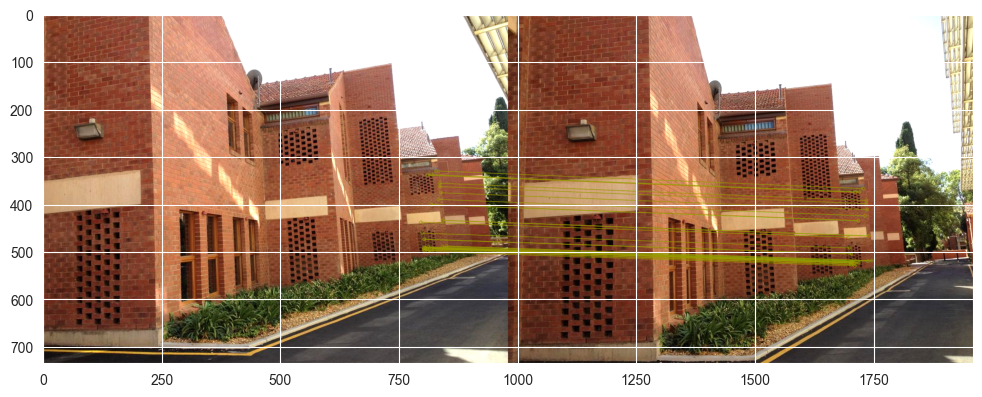

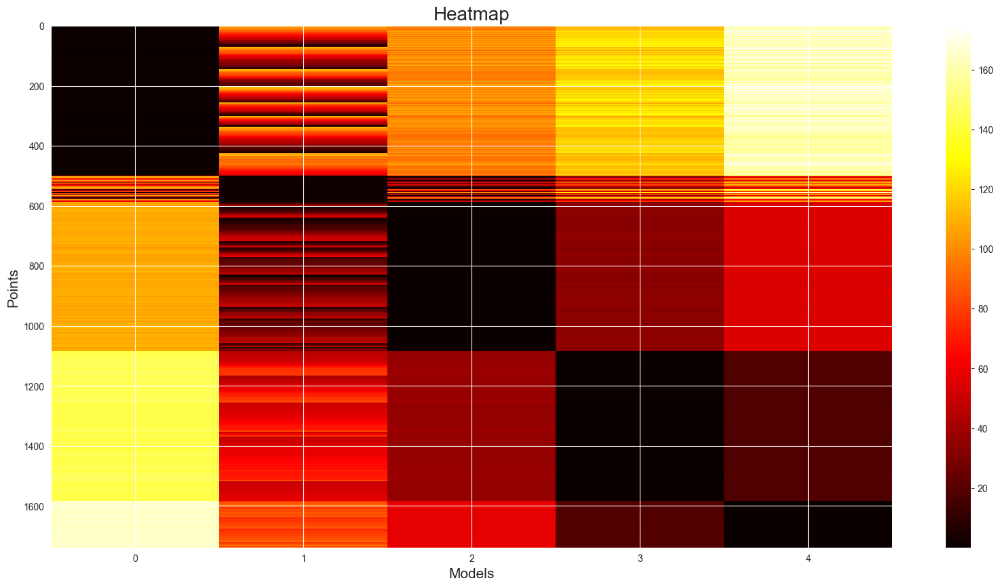

28.0 inliers found
the total number of point is:  38
The indexes of outlier points are: [29, 34, 35, 43, 46, 47, 54, 59, 81, 82]


<Figure size 640x480 with 0 Axes>

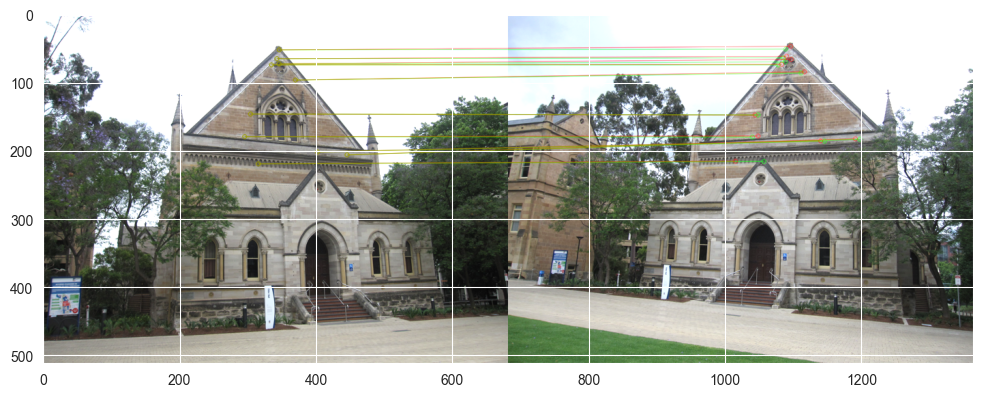

29.0 inliers found
the total number of point is:  46
The indexes of outlier points are: [15, 17, 18, 19, 22, 23, 32, 41, 42, 57, 68, 72, 73, 74, 75, 76, 80]


<Figure size 640x480 with 0 Axes>

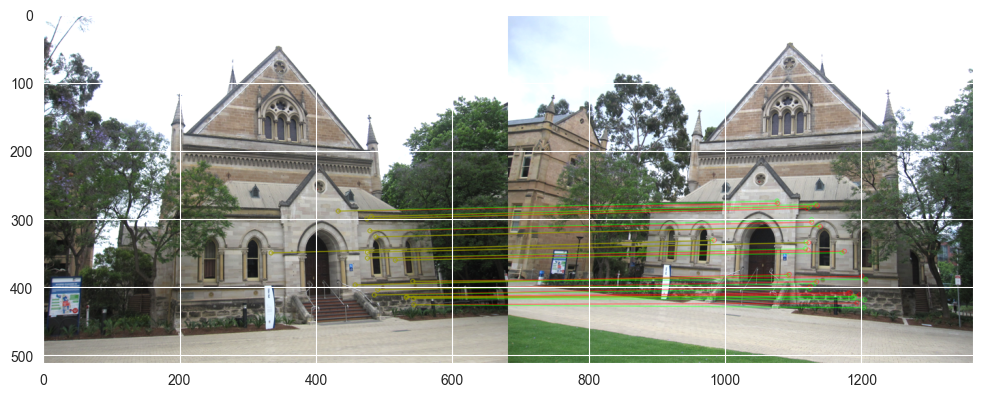

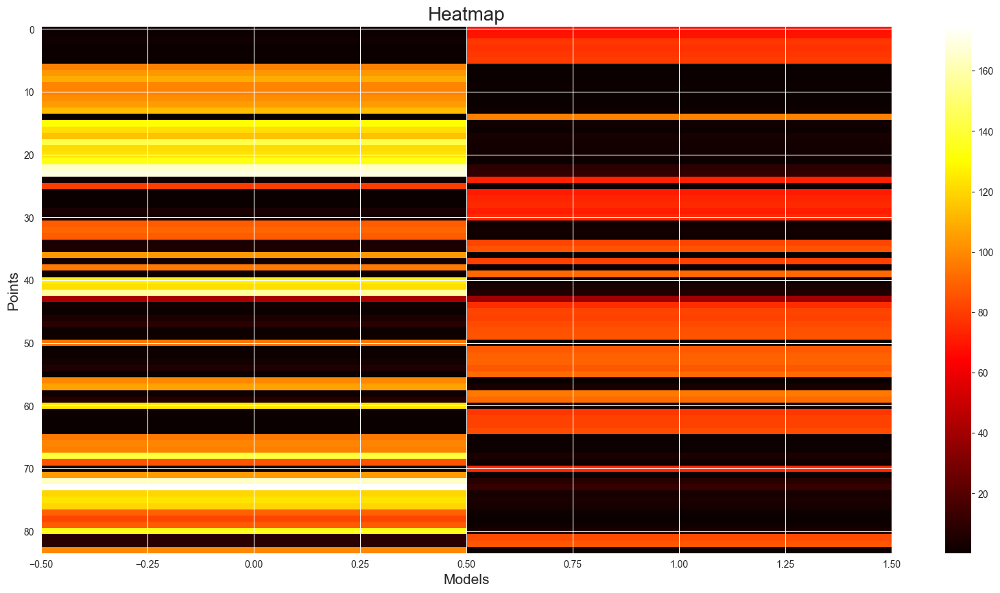

35.0 inliers found
the total number of point is:  42
The indexes of outlier points are: [66, 67, 72, 74, 80, 113, 116]


<Figure size 640x480 with 0 Axes>

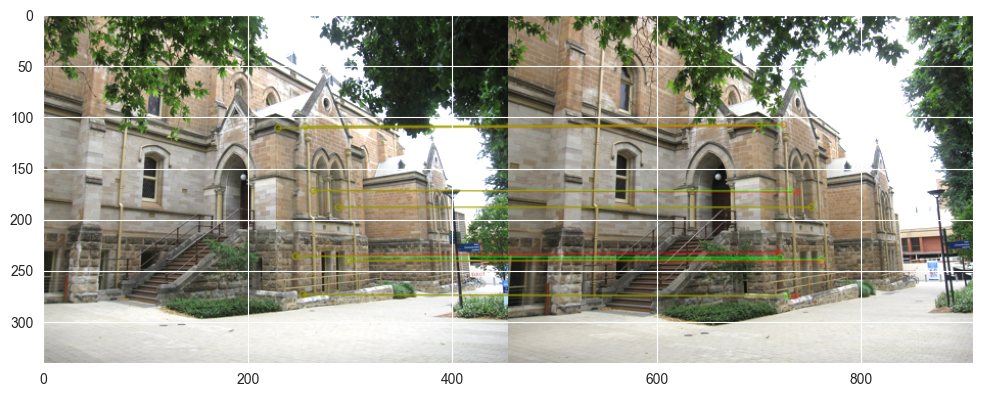

20.0 inliers found
the total number of point is:  28
The indexes of outlier points are: [22, 64, 65, 92, 127, 128, 129, 132]


<Figure size 640x480 with 0 Axes>

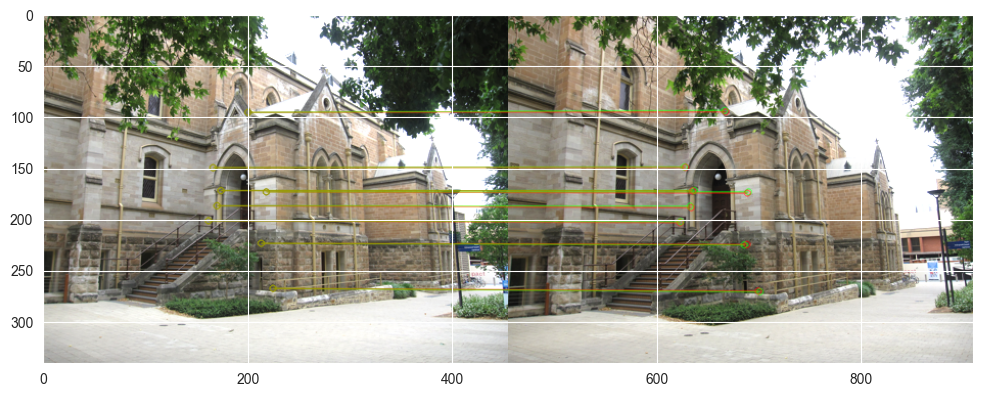

50.0 inliers found
the total number of point is:  63
The indexes of outlier points are: [1, 4, 11, 12, 20, 49, 53, 60, 90, 118, 119, 130, 131]


<Figure size 640x480 with 0 Axes>

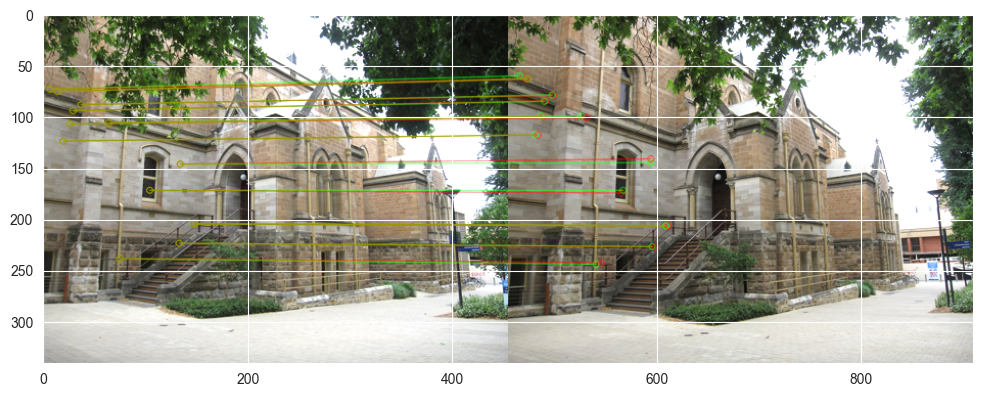

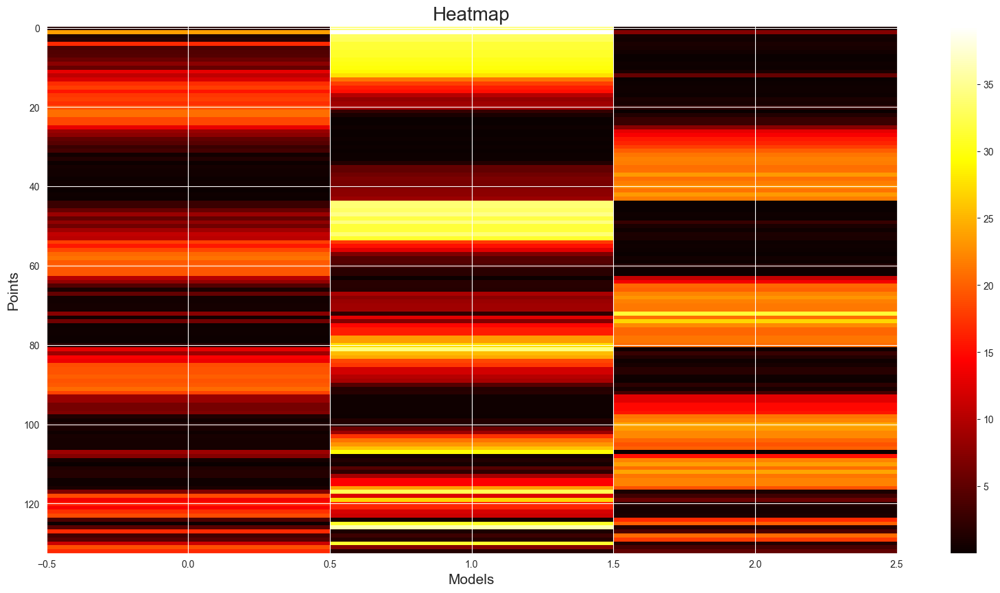

16.0 inliers found
the total number of point is:  20
The indexes of outlier points are: [304, 305, 304, 305, 455, 457]


<Figure size 640x480 with 0 Axes>

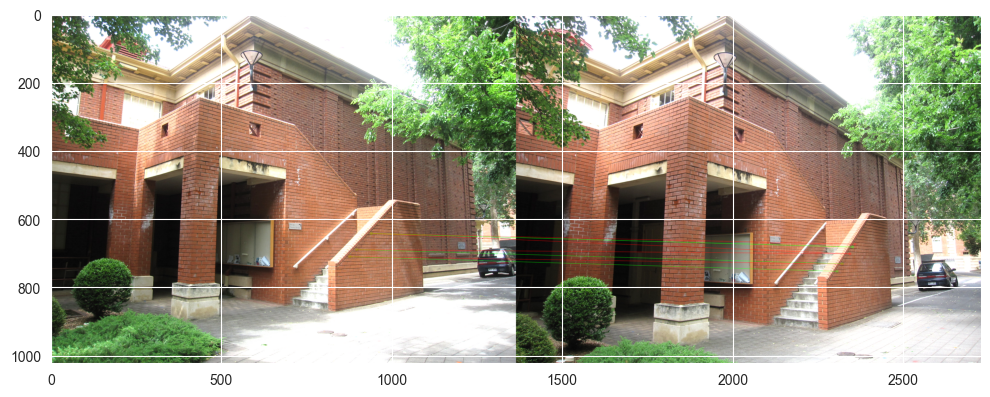

61.0 inliers found
the total number of point is:  77
The indexes of outlier points are: [136, 143, 425, 432, 447, 462, 495, 496, 515, 529, 531, 532, 551, 560, 565, 568]


<Figure size 640x480 with 0 Axes>

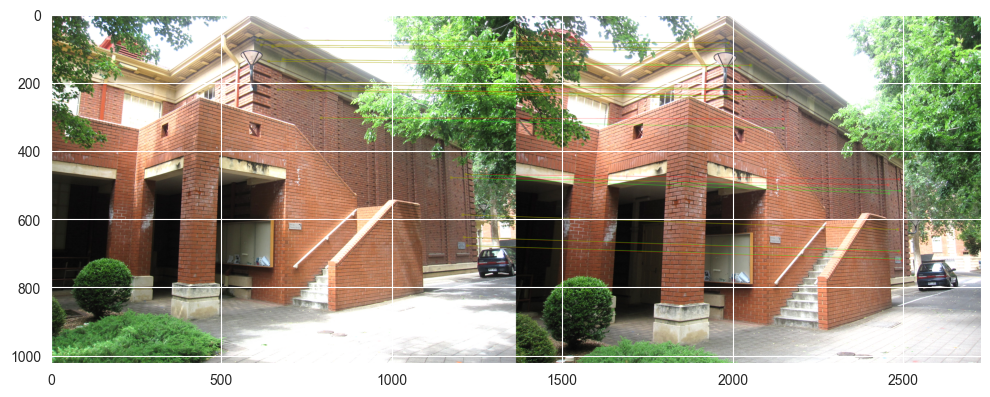

217.0 inliers found
the total number of point is:  291
The indexes of outlier points are: [75, 76, 79, 84, 88, 89, 91, 92, 93, 92, 93, 95, 97, 98, 99, 98, 99, 100, 103, 104, 105, 107, 109, 110, 111, 112, 168, 172, 182, 186, 198, 210, 221, 276, 351, 354, 356, 358, 359, 360, 361, 362, 367, 370, 376, 378, 381, 383, 384, 385, 389, 395, 397, 399, 406, 407, 413, 415, 442, 472, 473, 476, 478, 485, 506, 507, 508, 510, 521, 523, 526, 528, 549, 558, 559, 562, 564, 569]


<Figure size 640x480 with 0 Axes>

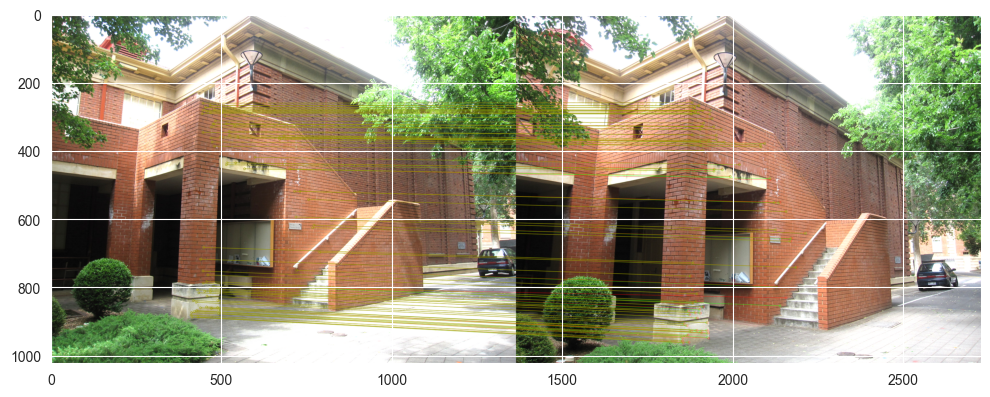

42.0 inliers found
the total number of point is:  69
The indexes of outlier points are: [42, 44, 49, 63, 64, 323, 324, 334, 338, 339, 343, 344, 343, 344, 345, 347, 349, 350, 349, 350, 468, 502, 519, 520, 546, 547, 553, 554, 556, 557, 563]


<Figure size 640x480 with 0 Axes>

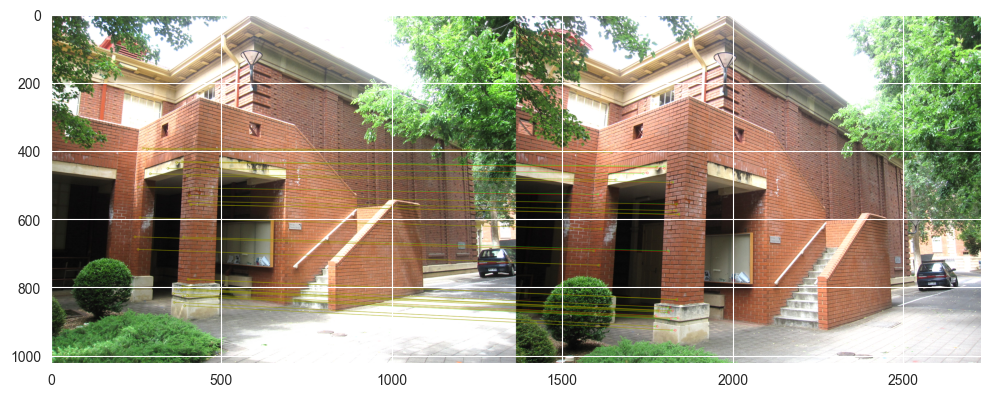

26.0 inliers found
the total number of point is:  41
The indexes of outlier points are: [117, 118, 119, 120, 123, 129, 403, 416, 419, 420, 482, 509, 524, 536, 537]


<Figure size 640x480 with 0 Axes>

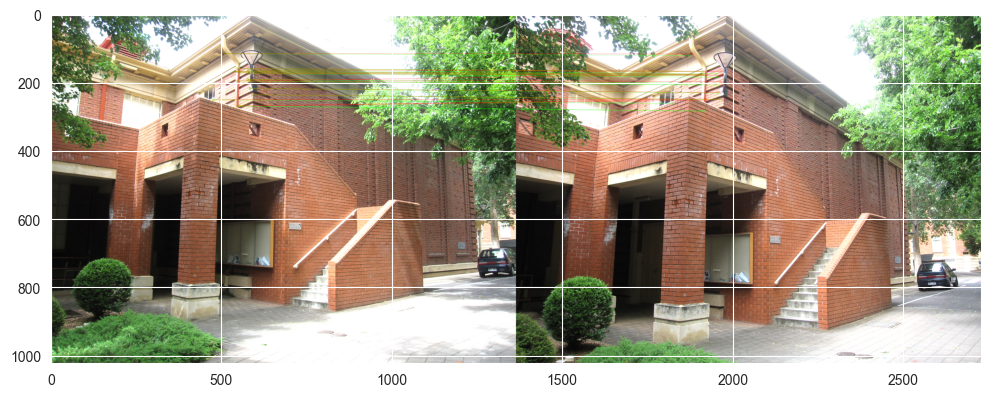

5.0 inliers found
the total number of point is:  15
The indexes of outlier points are: [41, 47, 325, 327, 501, 516, 517, 518, 545, 555]


<Figure size 640x480 with 0 Axes>

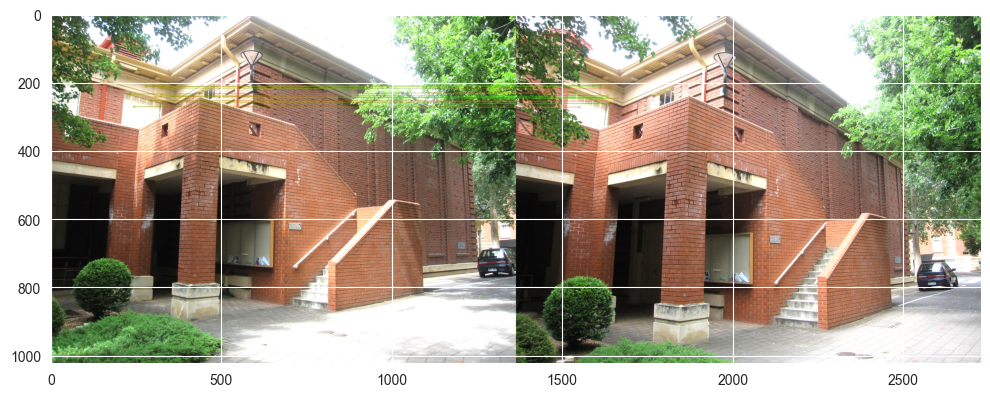

52.0 inliers found
the total number of point is:  58
The indexes of outlier points are: [2, 30, 466, 500, 567, 570]


<Figure size 640x480 with 0 Axes>

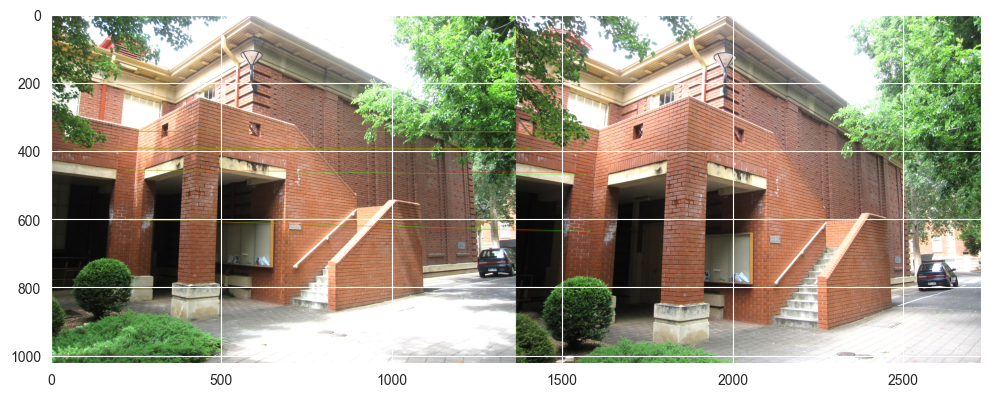

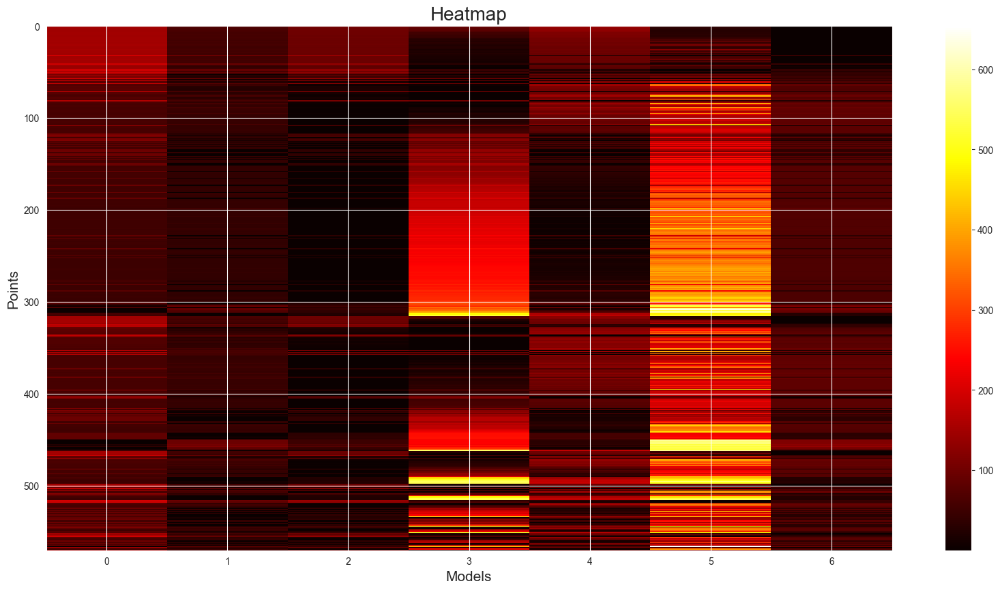

67.0 inliers found
the total number of point is:  86
The indexes of outlier points are: [2, 3, 6, 19, 20, 21, 41, 44, 49, 51, 62, 94, 101, 120, 121, 123, 126, 128, 130]


<Figure size 640x480 with 0 Axes>

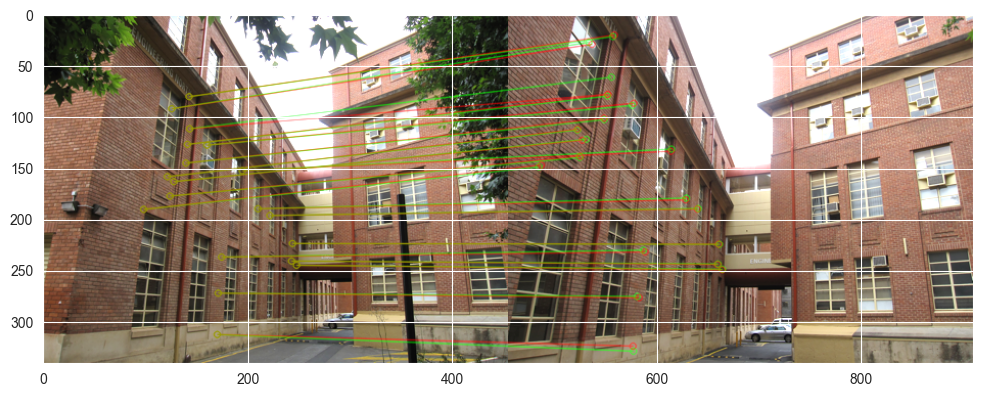

43.0 inliers found
the total number of point is:  46
The indexes of outlier points are: [107, 129, 131]


<Figure size 640x480 with 0 Axes>

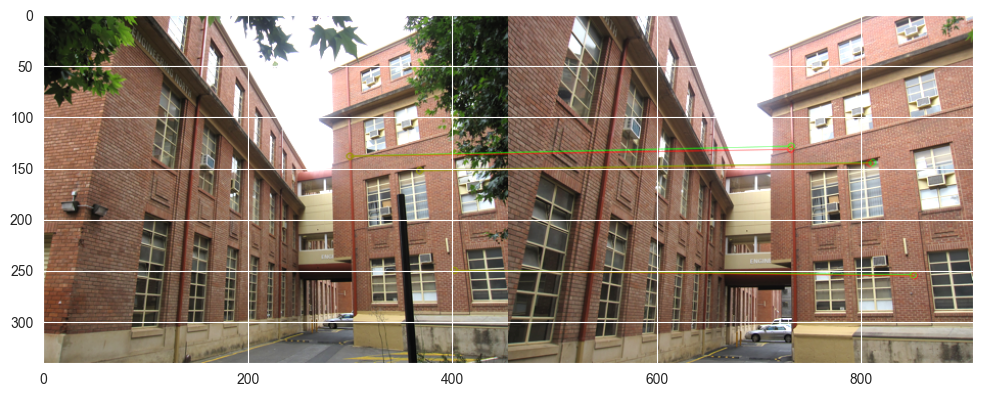

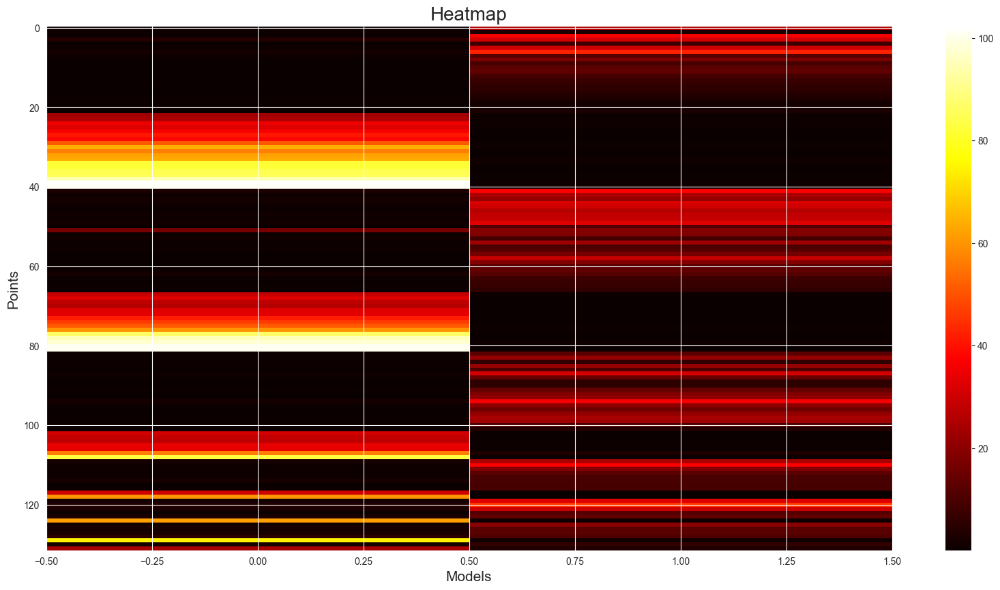

In [21]:
number_of_data_to_analyse=10
plot_heat=True

for i in range(number_of_data_to_analyse):
    data=mat_data[names[i]]
    res=build_residual_matrix(data, plot=True, method='ransac', threshold=thresholds[i])

    if plot_heat:
        plt.figure(figsize=(20, 10))  # Adjust figure size here
        plt.imshow(res, cmap='hot', interpolation='nearest', aspect="auto")
        #cbar = plt.colorbar()  # Add colorbar to show values
        plt.colorbar().ax.tick_params(labelsize=10)  # Adjust colorbar label size
        plt.title('Heatmap', fontsize=20)  # Adjust title font size
        plt.xlabel('Models', fontsize=15)  # Adjust x-axis label font size
        plt.ylabel('Points', fontsize=15)  # Adjust y-axis label font size
        plt.show()